In [1]:
#Chicago crime data Analysis.
#The Main Motivation for this project is form anyone whose  moving to New area is concern about the safty that area.

In [2]:
## Import all needed libraries
## Basic Analysis and Visualization packages

import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import math
from datetime import timedelta


In [3]:
# pre_processing

In [4]:
df = pd.read_csv('C:\\Users\\gpay5\\OneDrive\\Documents\\ML\\crimes_dataset.csv',parse_dates = True,na_values = "na")
df

,ID,Case Number,Date,Block,IUCR(Illinois Uniform Crime Reporting),Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,11646166,JC213529,09-01-2018 00:01,082XX S INGLESIDE AVE,810,THEFT,OVER $500,RESIDENCE,False,True,...,8.0,44.0,6,NaN,NaN,2018,04-06-2019 16:04,NaN,NaN,NaN
1,11645836,JC212333,05-01-2016 00:25,055XX S ROCKWELL ST,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,NaN,False,False,...,15.0,63.0,11,NaN,NaN,2016,04-06-2019 16:04,NaN,NaN,NaN
2,11449702,JB373031,07/31/2018 01:30:00 PM,009XX E HYDE PARK BLVD,2024,NARCOTICS,POSS: HEROIN(WHITE),STREET,True,False,...,5.0,41.0,18,NaN,NaN,2018,04-09-2019 16:24,NaN,NaN,NaN
3,11643334,JC209972,12/19/2018 04:30:00 PM,056XX W WELLINGTON AVE,1320,CRIMINAL DAMAGE,TO VEHICLE,STREET,False,False,...,31.0,19.0,14,NaN,NaN,2018,04-04-2019 16:16,NaN,NaN,NaN
4,11645527,JC212744,02-02-2015 10:00,069XX W ARCHER AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,OTHER,False,False,...,23.0,56.0,11,NaN,NaN,2015,04-06-2019 16:04,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,11202882,JB113208,01-12-2018 00:50,103XX S HALSTED ST,1310,CRIMINAL DAMAGE,TO PROPERTY,RESTAURANT,False,False,...,34.0,73.0,14,1172803.0,1836335.0,2018,05-04-2018 15:51,41.706332,-87.642814,"(41.706332184, -87.642813969)"
1048571,11202883,JB114521,01/13/2018 02:40:00 AM,031XX N LARAMIE AVE,312,ROBBERY,ARMED:KNIFE/CUTTING INSTRUMENT,SIDEWALK,False,False,...,30.0,19.0,3,1141159.0,1920198.0,2018,05-04-2018 15:51,41.937103,-87.756633,"(41.93710313, -87.756633218)"
1048572,11202884,JB114502,01/13/2018 02:07:00 AM,055XX S SPAULDING AVE,320,ROBBERY,STRONGARM - NO WEAPON,STREET,False,False,...,14.0,63.0,3,1155321.0,1867793.0,2018,05-04-2018 15:51,41.793025,-87.705993,"(41.793024934, -87.705992794)"
1048573,11202885,JB114544,01/13/2018 12:00:00 AM,051XX W SCHOOL ST,486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,38.0,15.0,08B,1141435.0,1921452.0,2018,05-04-2018 15:51,41.940539,-87.755588,"(41.940539129, -87.755587803)"


In [5]:
df.isnull().sum()

ID                                            0
Case Number                                   1
Date                                          0
Block                                         0
IUCR(Illinois Uniform Crime Reporting)        0
Primary Type                                  0
Description                                   0
Location Description                       6171
Arrest                                        0
Domestic                                      0
Beat                                          0
District                                      1
Ward                                      16664
Community Area                            16613
FBI Code                                      0
X Coordinate                              88001
Y Coordinate                              88001
Year                                          0
Updated On                                    0
Latitude                                  88001
Longitude                               

In [6]:
## Data cleaning

In [7]:
print(df.isna().sum())

ID                                            0
Case Number                                   1
Date                                          0
Block                                         0
IUCR(Illinois Uniform Crime Reporting)        0
Primary Type                                  0
Description                                   0
Location Description                       6171
Arrest                                        0
Domestic                                      0
Beat                                          0
District                                      1
Ward                                      16664
Community Area                            16613
FBI Code                                      0
X Coordinate                              88001
Y Coordinate                              88001
Year                                          0
Updated On                                    0
Latitude                                  88001
Longitude                               

In [8]:
df.dropna()

,ID,Case Number,Date,Block,IUCR(Illinois Uniform Crime Reporting),Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
6,10224881,HY411873,09-03-2015 18:00,044XX S UNIVERSITY AVE,1310,CRIMINAL DAMAGE,TO PROPERTY,RESIDENCE,False,False,...,4.0,39.0,14,1184667.0,1875669.0,2015,02-10-2018 15:50,41.813999,-87.598138,"(41.81399924, -87.598137918)"
11,10225155,HY412177,09-05-2015 22:42,007XX W IRVING PARK RD,470,PUBLIC PEACE VIOLATION,RECKLESS CONDUCT,STREET,True,False,...,46.0,3.0,24,1170563.0,1926785.0,2015,02-10-2018 15:50,41.954584,-87.648376,"(41.954584472, -87.648375776)"
15,10225206,HY412253,09-06-2015 01:10,047XX S STATE ST,041A,BATTERY,AGGRAVATED: HANDGUN,VACANT LOT/LAND,False,False,...,3.0,38.0,04B,1177070.0,1873609.0,2015,02-10-2018 15:50,41.808521,-87.626066,"(41.80852139, -87.62606631)"
17,10225234,HY412306,09-06-2015 02:00,002XX N ST LOUIS AVE,420,BATTERY,AGGRAVATED:KNIFE/CUTTING INSTR,SIDEWALK,False,False,...,28.0,27.0,04B,1153006.0,1901570.0,2015,02-10-2018 15:50,41.885759,-87.713588,"(41.885759278, -87.713588042)"
23,10225308,HY412341,09-06-2015 02:35,013XX W ADDISON ST,2230,LIQUOR LAW VIOLATION,ILLEGAL CONSUMPTION BY MINOR,SIDEWALK,True,False,...,44.0,6.0,22,1166847.0,1924028.0,2015,09/17/2015 11:37:18 AM,41.947100,-87.662116,"(41.947099832, -87.662115668)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,11202882,JB113208,01-12-2018 00:50,103XX S HALSTED ST,1310,CRIMINAL DAMAGE,TO PROPERTY,RESTAURANT,False,False,...,34.0,73.0,14,1172803.0,1836335.0,2018,05-04-2018 15:51,41.706332,-87.642814,"(41.706332184, -87.642813969)"
1048571,11202883,JB114521,01/13/2018 02:40:00 AM,031XX N LARAMIE AVE,312,ROBBERY,ARMED:KNIFE/CUTTING INSTRUMENT,SIDEWALK,False,False,...,30.0,19.0,3,1141159.0,1920198.0,2018,05-04-2018 15:51,41.937103,-87.756633,"(41.93710313, -87.756633218)"
1048572,11202884,JB114502,01/13/2018 02:07:00 AM,055XX S SPAULDING AVE,320,ROBBERY,STRONGARM - NO WEAPON,STREET,False,False,...,14.0,63.0,3,1155321.0,1867793.0,2018,05-04-2018 15:51,41.793025,-87.705993,"(41.793024934, -87.705992794)"
1048573,11202885,JB114544,01/13/2018 12:00:00 AM,051XX W SCHOOL ST,486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,38.0,15.0,08B,1141435.0,1921452.0,2018,05-04-2018 15:51,41.940539,-87.755588,"(41.940539129, -87.755587803)"


In [9]:
df.describe(include='all')

,ID,Case Number,Date,Block,IUCR(Illinois Uniform Crime Reporting),Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
count,1.048575e+06,1048574,1048575,1048575,1048575,1048575,1048575,1042404,1048575,1048575,...,1.031911e+06,1.031962e+06,1048575,9.605740e+05,9.605740e+05,1.048575e+06,1048575,960574.000000,960574.000000,960574
unique,NaN,1048563,518191,39482,378,35,491,165,2,2,...,NaN,NaN,26,NaN,NaN,NaN,5180,NaN,NaN,293344
top,NaN,G491428,01-01-2015 00:01,001XX N STATE ST,820,THEFT,SIMPLE,STREET,False,False,...,NaN,NaN,6,NaN,NaN,NaN,02-10-2018 15:50,NaN,NaN,"(41.795991039, -87.630542489)"
freq,NaN,3,173,2963,90316,241893,114116,248275,833934,886874,...,NaN,NaN,241893,NaN,NaN,NaN,711766,NaN,NaN,1910
mean,1.039886e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.309469e+01,3.687818e+01,NaN,1.164760e+06,1.886328e+06,2.015957e+03,NaN,41.843675,-87.670892,NaN
std,2.200618e+06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.401313e+01,2.147620e+01,NaN,1.699006e+04,3.226237e+04,4.435791e+00,NaN,0.088763,0.061586,NaN
min,6.700000e+02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.000000e+00,0.000000e+00,NaN,0.000000e+00,0.000000e+00,2.001000e+03,NaN,36.619446,-91.686566,NaN
25%,1.025596e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.000000e+01,2.300000e+01,NaN,1.153142e+06,1.859293e+06,2.015000e+03,NaN,41.769225,-87.713038,NaN
50%,1.069079e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.400000e+01,3.200000e+01,NaN,1.166467e+06,1.892896e+06,2.016000e+03,NaN,41.861865,-87.664587,NaN
75%,1.108648e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.400000e+01,5.500000e+01,NaN,1.176436e+06,1.909051e+06,2.017000e+03,NaN,41.906276,-87.627877,NaN


In [10]:
print(df.isnull().sum())

ID                                            0
Case Number                                   1
Date                                          0
Block                                         0
IUCR(Illinois Uniform Crime Reporting)        0
Primary Type                                  0
Description                                   0
Location Description                       6171
Arrest                                        0
Domestic                                      0
Beat                                          0
District                                      1
Ward                                      16664
Community Area                            16613
FBI Code                                      0
X Coordinate                              88001
Y Coordinate                              88001
Year                                          0
Updated On                                    0
Latitude                                  88001
Longitude                               

In [11]:
#Statistics

In [12]:
len(df.ID.unique())

1048575

In [13]:
df.ID.count()

1048575

In [14]:
df.info

<bound method DataFrame.info of                ID Case Number                    Date                   Block  \
0        11646166    JC213529        09-01-2018 00:01   082XX S INGLESIDE AVE   
1        11645836    JC212333        05-01-2016 00:25     055XX S ROCKWELL ST   
2        11449702    JB373031  07/31/2018 01:30:00 PM  009XX E HYDE PARK BLVD   
3        11643334    JC209972  12/19/2018 04:30:00 PM  056XX W WELLINGTON AVE   
4        11645527    JC212744        02-02-2015 10:00      069XX W ARCHER AVE   
...           ...         ...                     ...                     ...   
1048570  11202882    JB113208        01-12-2018 00:50      103XX S HALSTED ST   
1048571  11202883    JB114521  01/13/2018 02:40:00 AM     031XX N LARAMIE AVE   
1048572  11202884    JB114502  01/13/2018 02:07:00 AM   055XX S SPAULDING AVE   
1048573  11202885    JB114544  01/13/2018 12:00:00 AM       051XX W SCHOOL ST   
1048574  11202886    JB114527  01/13/2018 03:30:00 AM      006XX S PULASKI RD

In [15]:
df.index

RangeIndex(start=0, stop=1048575, step=1)

In [16]:
df.columns

Index(['ID', 'Case Number', 'Date', 'Block',
       'IUCR(Illinois Uniform Crime Reporting)', 'Primary Type', 'Description',
       'Location Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community Area', 'FBI Code', 'X Coordinate', 'Y Coordinate',
       'Year', 'Updated On', 'Latitude', 'Longitude', 'Location'],
      dtype='object')

In [17]:
for i in df.columns:
    cname = i
    i=i.replace(" ","_")
    df.rename(columns={cname:i}, inplace = True)
new_column_names = df.columns
print(new_column_names)

Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Primary_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Updated_On', 'Latitude', 'Longitude', 'Location'],
      dtype='object')


In [18]:
df.set_index('Case_Number')

,ID,Date,Block,IUCR(Illinois_Uniform_Crime_Reporting),Primary_Type,Description,Location_Description,Arrest,Domestic,Beat,...,Ward,Community_Area,FBI_Code,X_Coordinate,Y_Coordinate,Year,Updated_On,Latitude,Longitude,Location
Case_Number,,,,,,,,,,,,,,,,,,,,,
JC213529,11646166,09-01-2018 00:01,082XX S INGLESIDE AVE,810,THEFT,OVER $500,RESIDENCE,False,True,631,...,8.0,44.0,6,NaN,NaN,2018,04-06-2019 16:04,NaN,NaN,NaN
JC212333,11645836,05-01-2016 00:25,055XX S ROCKWELL ST,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,NaN,False,False,824,...,15.0,63.0,11,NaN,NaN,2016,04-06-2019 16:04,NaN,NaN,NaN
JB373031,11449702,07/31/2018 01:30:00 PM,009XX E HYDE PARK BLVD,2024,NARCOTICS,POSS: HEROIN(WHITE),STREET,True,False,233,...,5.0,41.0,18,NaN,NaN,2018,04-09-2019 16:24,NaN,NaN,NaN
JC209972,11643334,12/19/2018 04:30:00 PM,056XX W WELLINGTON AVE,1320,CRIMINAL DAMAGE,TO VEHICLE,STREET,False,False,2514,...,31.0,19.0,14,NaN,NaN,2018,04-04-2019 16:16,NaN,NaN,NaN
JC212744,11645527,02-02-2015 10:00,069XX W ARCHER AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,OTHER,False,False,811,...,23.0,56.0,11,NaN,NaN,2015,04-06-2019 16:04,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
JB113208,11202882,01-12-2018 00:50,103XX S HALSTED ST,1310,CRIMINAL DAMAGE,TO PROPERTY,RESTAURANT,False,False,2232,...,34.0,73.0,14,1172803.0,1836335.0,2018,05-04-2018 15:51,41.706332,-87.642814,"(41.706332184, -87.642813969)"
JB114521,11202883,01/13/2018 02:40:00 AM,031XX N LARAMIE AVE,312,ROBBERY,ARMED:KNIFE/CUTTING INSTRUMENT,SIDEWALK,False,False,2521,...,30.0,19.0,3,1141159.0,1920198.0,2018,05-04-2018 15:51,41.937103,-87.756633,"(41.93710313, -87.756633218)"
JB114502,11202884,01/13/2018 02:07:00 AM,055XX S SPAULDING AVE,320,ROBBERY,STRONGARM - NO WEAPON,STREET,False,False,822,...,14.0,63.0,3,1155321.0,1867793.0,2018,05-04-2018 15:51,41.793025,-87.705993,"(41.793024934, -87.705992794)"


In [19]:
## convert time objects
df['Date'] = pd.to_datetime(df['Date'])
date = df['Date']
df['Date'] = [d.date() for d in date]
df["Month"] = date.dt.month
df['Day'] = date.dt.day_name()
df["Year"] = date.dt.year
df['Time'] = [d.time() for d in date]
df['timeint'] = (date-date.dt.normalize()).dt.total_seconds()/timedelta(days = 1).total_seconds()

df['Updated_On'] = pd.to_datetime(df['Updated_On'])
updated_date = df['Updated_On']
df['Updated_Date'] = [d.date() for d in updated_date]
df["Updated_Month"] = updated_date.dt.month
df['Updated_Day'] = updated_date.dt.day_name()
df["Updated_Year"] = updated_date.dt.year
df['Updated_Time'] = [d.time() for d in updated_date]
df['Updated_timeint'] = (updated_date-updated_date.dt.normalize()).dt.total_seconds()/timedelta(days = 1).total_seconds()

In [20]:
df.columns

Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Primary_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Updated_On', 'Latitude', 'Longitude', 'Location', 'Month',
       'Day', 'Time', 'timeint', 'Updated_Date', 'Updated_Month',
       'Updated_Day', 'Updated_Year', 'Updated_Time', 'Updated_timeint'],
      dtype='object')

In [21]:
df = df[df['Location'].notnull()]

In [22]:
df.rename(columns = {'Primary_Type':'Crime_Type'}, inplace = True)
## df.drop(['Crime_Type'],axis = 1)
df.columns

C:\Users\gpay5\AppData\Local\Temp\ipykernel_17784\932455565.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.rename(columns = {'Primary_Type':'Crime_Type'}, inplace = True)


Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Crime_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Updated_On', 'Latitude', 'Longitude', 'Location', 'Month',
       'Day', 'Time', 'timeint', 'Updated_Date', 'Updated_Month',
       'Updated_Day', 'Updated_Year', 'Updated_Time', 'Updated_timeint'],
      dtype='object')

In [ ]:
#Visualisations

In [23]:
!pip install basemap

Defaulting to user installation because normal site-packages is not writeable


In [24]:
## Base Map
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt 

Text(0.5, 1.0, 'Geo Plotting')

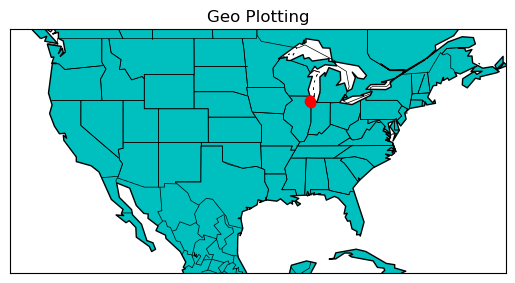

In [25]:
m = Basemap(projection='mill',llcrnrlat=20,urcrnrlat=50,\
                llcrnrlon=-130,urcrnrlon=-60,resolution='c')
m.drawcoastlines()
m.drawcountries()
m.drawstates()
m.fillcontinents(color='c',lake_color='#FFFFFF')

for index, row in df.head(20).iterrows():
    lat,lon =row['Latitude'],row['Longitude']
    x,y = m(lon,lat)
    m.plot(x,y, 'ro')

plt.title("Geo Plotting")

In [26]:
crimeType_sort=df.groupby('Date')['Date'].count().sort_values()
crimeType_sort

Date
2021-04-20       1
2014-02-06       1
2002-03-11       1
2002-03-01       1
2002-02-23       1
              ... 
2023-01-01     944
2015-08-01     959
2016-09-01     975
2016-01-01     978
2017-01-01    1007
Name: Date, Length: 7860, dtype: int64

In [27]:
crimeType_largest=df.groupby("Crime_Type")['Crime_Type'].count().sort_values().nlargest(10)
crimeType_largest

Crime_Type
THEFT                  219016
BATTERY                177508
CRIMINAL DAMAGE        106850
ASSAULT                 69707
OTHER OFFENSE           60615
DECEPTIVE PRACTICE      57176
NARCOTICS               50690
MOTOR VEHICLE THEFT     49334
BURGLARY                45916
ROBBERY                 39552
Name: Crime_Type, dtype: int64

In [28]:
crimeType=df.groupby("Crime_Type")['Crime_Type'].count().sort_values()
crimeType

Crime_Type
NON-CRIMINAL (SUBJECT SPECIFIED)          3
OTHER NARCOTIC VIOLATION                 21
NON - CRIMINAL                           23
PUBLIC INDECENCY                         35
HUMAN TRAFFICKING                        35
NON-CRIMINAL                             96
OBSCENITY                               206
CONCEALED CARRY LICENSE VIOLATION       249
HOMICIDE                                251
INTIMIDATION                            564
KIDNAPPING                              661
STALKING                                772
GAMBLING                                862
LIQUOR LAW VIOLATION                    899
CRIMINAL SEXUAL ASSAULT                1108
ARSON                                  1774
PROSTITUTION                           3317
INTERFERENCE WITH PUBLIC OFFICER       3546
SEX OFFENSE                            3587
CRIM SEXUAL ASSAULT                    4179
PUBLIC PEACE VIOLATION                 5973
OFFENSE INVOLVING CHILDREN             7560
WEAPONS VIOLATION    

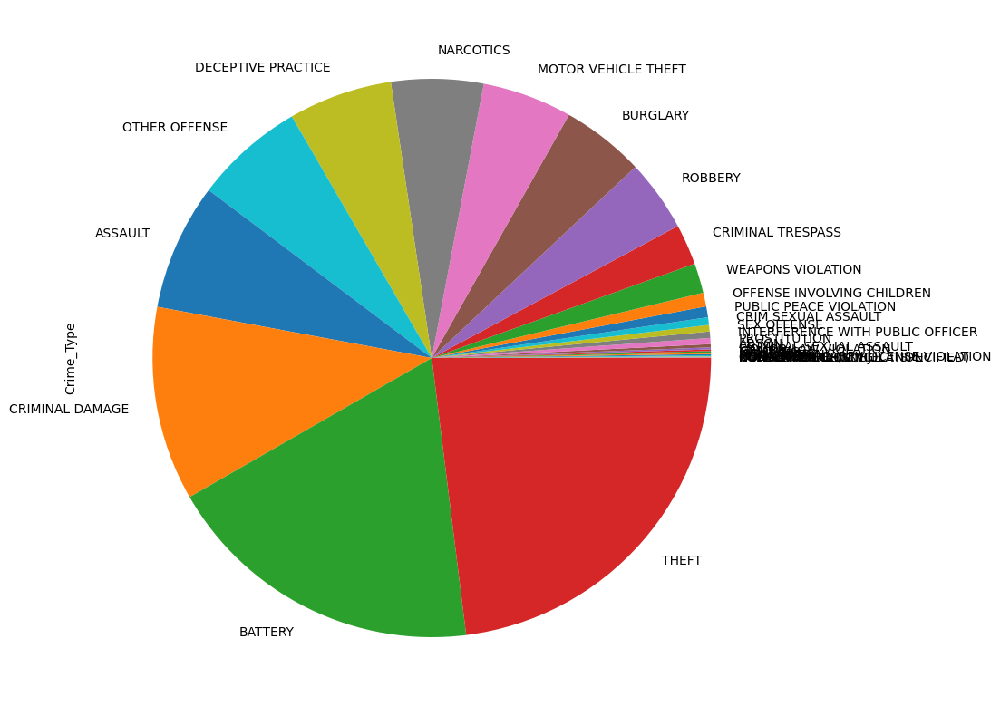

In [29]:
pie_plot= crimeType.plot.pie(figsize=(10,10))

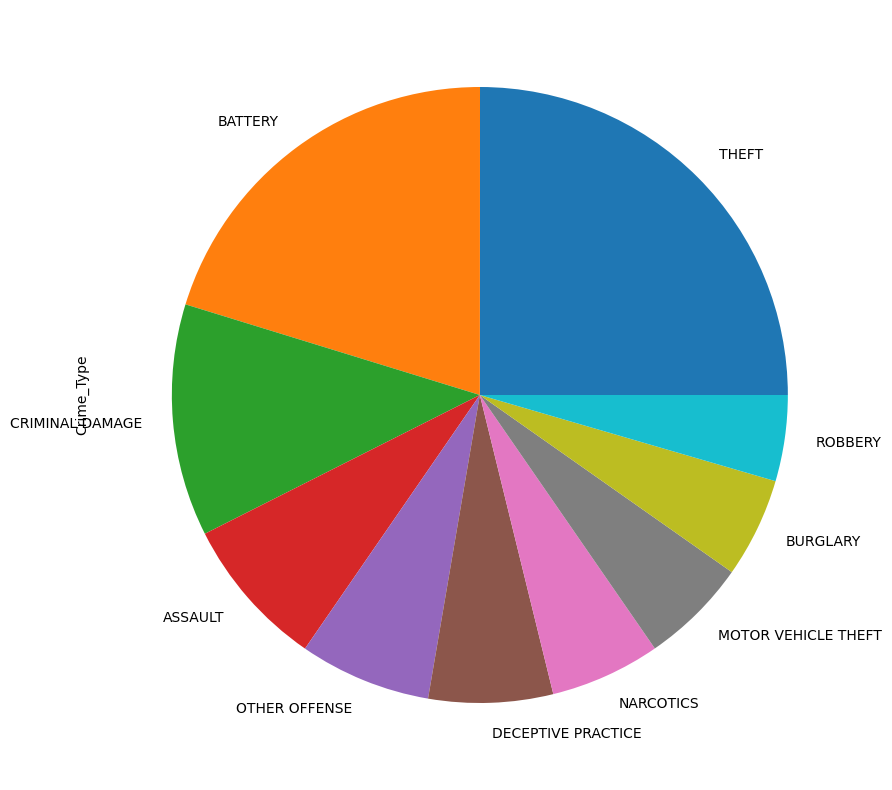

In [30]:
pie_plot_largest= crimeType_largest.plot.pie(figsize=(10,10))

In [31]:
crimeType_year = df.groupby('Year')['Crime_Type'].count()
print(crimeType_year)

Year
2001       121
2002      4104
2003      5487
2004      5493
2005      5188
2006      5259
2007      5315
2008      5223
2009      4708
2010      4723
2011      4319
2012      4166
2013      3934
2014      4298
2015    211086
2016    265646
2017    263011
2018      9658
2019      2983
2020      2342
2021      2243
2022      2541
2023    129046
Name: Crime_Type, dtype: int64


In [32]:
df['Crime_Type'].value_counts()

THEFT                                219016
BATTERY                              177508
CRIMINAL DAMAGE                      106850
ASSAULT                               69707
OTHER OFFENSE                         60615
DECEPTIVE PRACTICE                    57176
NARCOTICS                             50690
MOTOR VEHICLE THEFT                   49334
BURGLARY                              45916
ROBBERY                               39552
CRIMINAL TRESPASS                     22389
WEAPONS VIOLATION                     16420
OFFENSE INVOLVING CHILDREN             7560
PUBLIC PEACE VIOLATION                 5973
CRIM SEXUAL ASSAULT                    4179
SEX OFFENSE                            3587
INTERFERENCE WITH PUBLIC OFFICER       3546
PROSTITUTION                           3317
ARSON                                  1774
CRIMINAL SEXUAL ASSAULT                1108
LIQUOR LAW VIOLATION                    899
GAMBLING                                862
STALKING                        

Text(0.5, 1.0, 'crime data ')

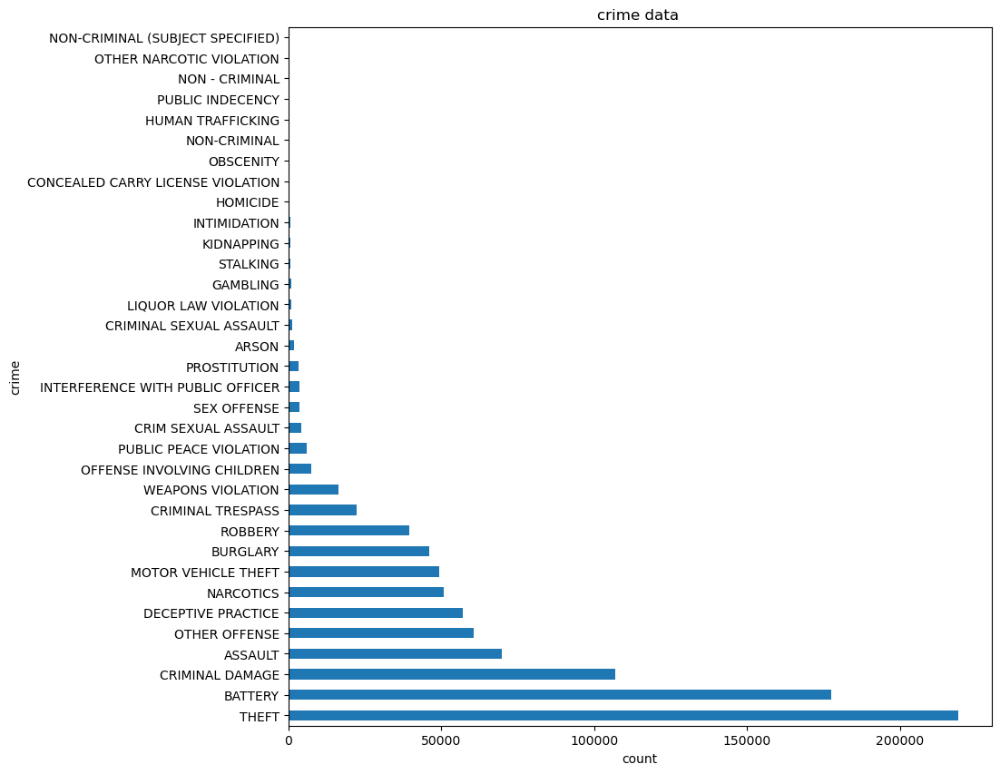

In [33]:
df['Crime_Type'].value_counts().plot.barh(x='crime',y='count',figsize=(10,10))
plt.xlabel('count')
plt.ylabel('crime')
plt.title('crime data ')

In [34]:
df.columns

Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Crime_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Updated_On', 'Latitude', 'Longitude', 'Location', 'Month',
       'Day', 'Time', 'timeint', 'Updated_Date', 'Updated_Month',
       'Updated_Day', 'Updated_Year', 'Updated_Time', 'Updated_timeint'],
      dtype='object')

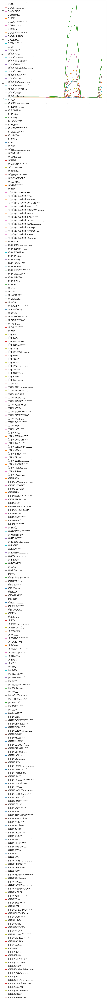

In [35]:
fig, ax = plt.subplots(figsize=(20,20))
#ax.set_xticklabels([])
ax.legend_ = None
#draw()
trial = df.drop(['Location_Description', 'Ward', 'Domestic','Community_Area', 'District', 'Longitude', 'Arrest', 'Latitude', 'Location'], axis=1)
trial.groupby(['Year','Crime_Type']).count().unstack().plot(ax=ax)
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_17268\4147794662.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = df.corr()


<Axes: >

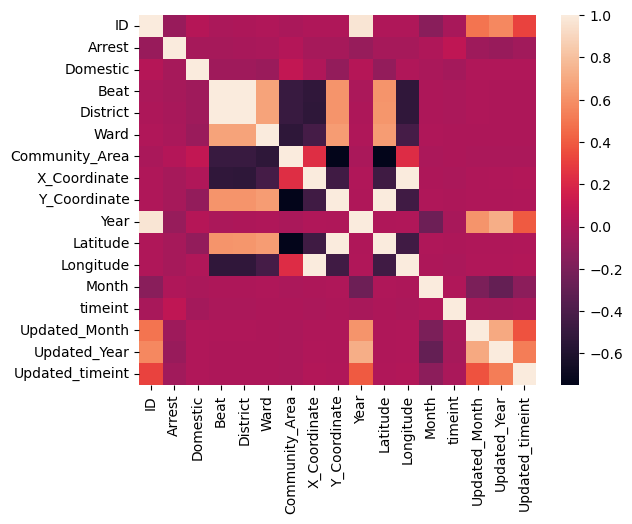

In [36]:
#Correlation chart
corr = df.corr()
sns.heatmap(corr,
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values)

In [37]:
Crime_Type=df['Crime_Type']
Crime_Type

6                 CRIMINAL DAMAGE
11         PUBLIC PEACE VIOLATION
15                        BATTERY
17                        BATTERY
23           LIQUOR LAW VIOLATION
                    ...          
1048570           CRIMINAL DAMAGE
1048571                   ROBBERY
1048572                   ROBBERY
1048573                   BATTERY
1048574                     THEFT
Name: Crime_Type, Length: 950894, dtype: object

In [38]:
Year=df['Year']
Year

6          2015
11         2015
15         2015
17         2015
23         2015
           ... 
1048570    2018
1048571    2018
1048572    2018
1048573    2018
1048574    2018
Name: Year, Length: 950894, dtype: int64

In [39]:
District=df['District']
District

6           2.0
11         19.0
15          2.0
17         11.0
23         19.0
           ... 
1048570    22.0
1048571    25.0
1048572     8.0
1048573    16.0
1048574    11.0
Name: District, Length: 950894, dtype: float64

In [40]:
Beat=df['Beat']
Beat

6           222
11         1915
15          224
17         1123
23         1923
           ... 
1048570    2232
1048571    2521
1048572     822
1048573    1634
1048574    1132
Name: Beat, Length: 950894, dtype: int64

In [41]:
Beat=df['Beat']
Beat

6           222
11         1915
15          224
17         1123
23         1923
           ... 
1048570    2232
1048571    2521
1048572     822
1048573    1634
1048574    1132
Name: Beat, Length: 950894, dtype: int64

In [42]:
Community_Area=df['Community_Area']
Community_Area

6          39.0
11          3.0
15         38.0
17         27.0
23          6.0
           ... 
1048570    73.0
1048571    19.0
1048572    63.0
1048573    15.0
1048574    26.0
Name: Community_Area, Length: 950894, dtype: float64

In [43]:
Ward=df['Ward']
Ward

6           4.0
11         46.0
15          3.0
17         28.0
23         44.0
           ... 
1048570    34.0
1048571    30.0
1048572    14.0
1048573    38.0
1048574    24.0
Name: Ward, Length: 950894, dtype: float64

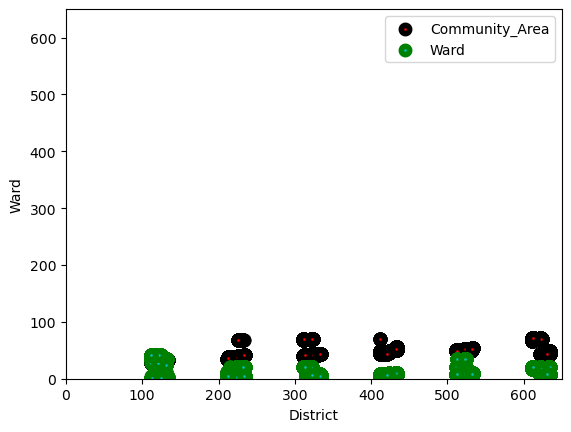

In [44]:
plt.scatter(Beat,Community_Area,color='r',label='Community_Area',edgecolors='k',linewidths=4)
plt.scatter(Beat,Ward,color='c',label='Ward',edgecolors='g',linewidths=4)
plt.axis([0,650,0,650])
plt.xlabel('District')
plt.ylabel('Ward')
plt.legend()
plt.show()

In [45]:
Arrest = df.groupby('Year')['Arrest'].count()
Arrest

Year
2001       121
2002      4104
2003      5487
2004      5493
2005      5188
2006      5259
2007      5315
2008      5223
2009      4708
2010      4723
2011      4319
2012      4166
2013      3934
2014      4298
2015    211086
2016    265646
2017    263011
2018      9658
2019      2983
2020      2342
2021      2243
2022      2541
2023    129046
Name: Arrest, dtype: int64

In [46]:
res=df.groupby('Arrest')['Arrest'].agg('count').sort_values(ascending=False)
res

Arrest
False    758256
True     192638
Name: Arrest, dtype: int64

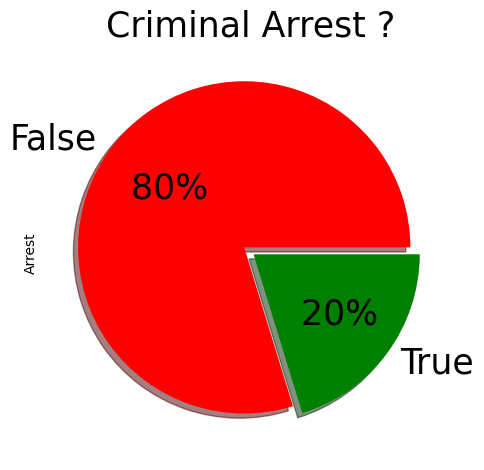

In [47]:
res.plot(kind='pie',figsize=(5,5),autopct='%3.0f%%',colors=['red','green'],shadow=True,fontsize=25,explode=[0.05,.02])
plt.title('Criminal Arrest ?', fontsize=25)
plt.tight_layout()

In [48]:
Crime_Type=df['Crime_Type']
Crime_Type

6                 CRIMINAL DAMAGE
11         PUBLIC PEACE VIOLATION
15                        BATTERY
17                        BATTERY
23           LIQUOR LAW VIOLATION
                    ...          
1048570           CRIMINAL DAMAGE
1048571                   ROBBERY
1048572                   ROBBERY
1048573                   BATTERY
1048574                     THEFT
Name: Crime_Type, Length: 950894, dtype: object

In [49]:
primary_top=df['Crime_Type'].value_counts().head(9).to_frame(name='count').reset_index()

In [50]:
Type_year= df.groupby(['Crime_Type','Year']).size().reset_index(name='counts')

In [51]:
type_year_top9=Type_year[Type_year['Crime_Type'].isin(primary_top['index'])]

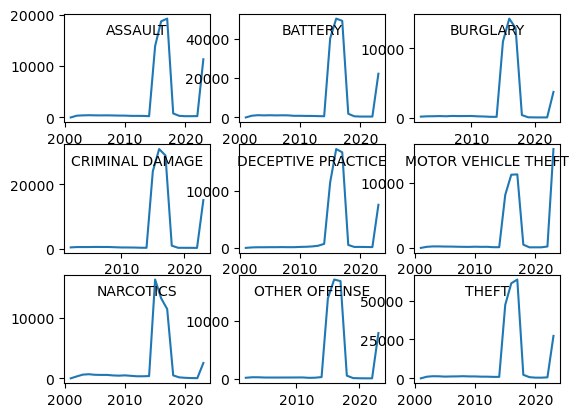

In [52]:
from pandas.core.groupby import groupby
fig,ax = plt.subplots(3,3)
row = 0
column = 0
for label, group in type_year_top9.groupby('Crime_Type'):
  ax[row, column].plot(group['Year'],group['counts'])
  ax[row, column].set_title(label,y=1.0,pad=-15,fontsize=10)
  if column == 2:
    column = 0
  elif column < 2:
    column += 1
  if column == 0 :
    row += 1

In [53]:
!pip install basemap

Defaulting to user installation because normal site-packages is not writeable


In [54]:
!pip install geopandas
!pip install descartes

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [55]:
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
from matplotlib.patches import PathPatch
import math
from matplotlib.pyplot import figure, pie


Text(0.5, 1.0, 'Crimes by District')

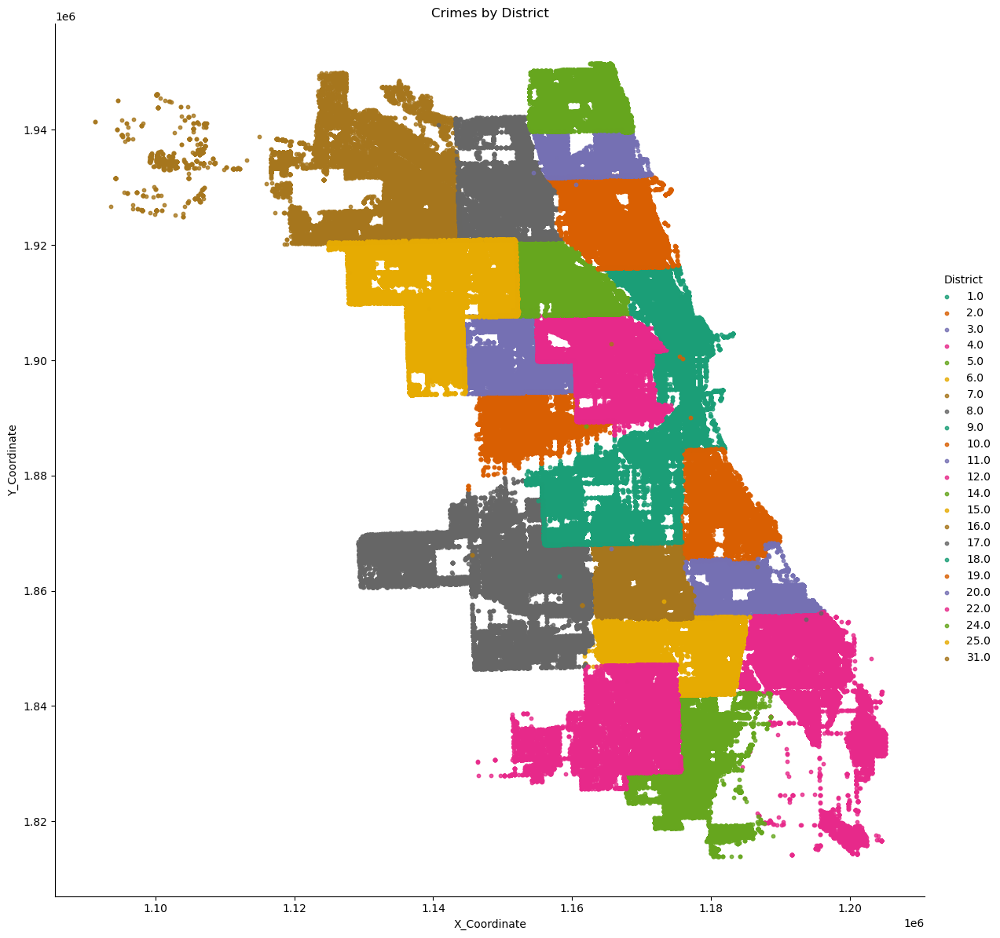

In [56]:
# A full Chicago crime by district. Maybe helpful for later when comparing our clusters

new_crimes_data = df[df['X_Coordinate']!=0]
sns.lmplot(x='X_Coordinate',
           y='Y_Coordinate',
           data=new_crimes_data,
           fit_reg=False,
           hue="District",
           palette='Dark2',
           height=12,
           ci=2,
           scatter_kws={"marker": "D",
                        "s": 10})
ax = plt.gca()
ax.set_title("Crimes by District")

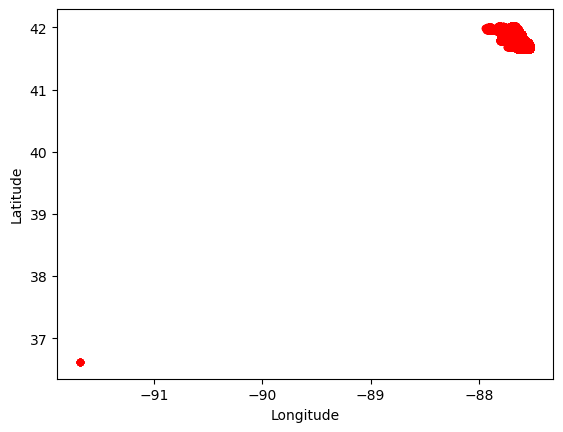

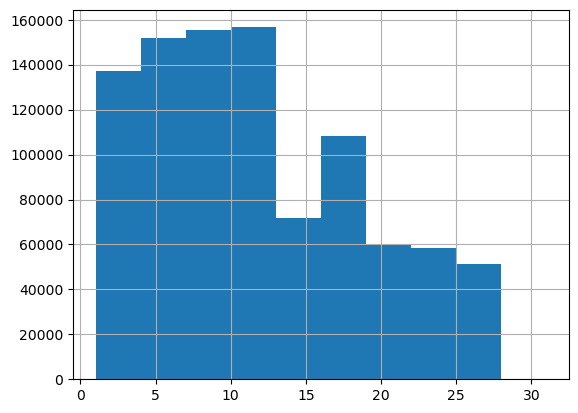

In [57]:
df.plot(kind='scatter',x='Longitude',y='Latitude',color='red')
plt.show()
df['District'].hist()
plt.show()

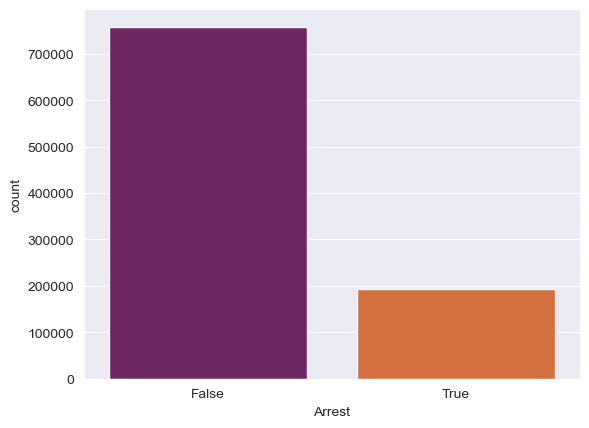

In [58]:
sns.set_style("darkgrid")
sns.countplot(x="Arrest", palette='inferno', data=df);

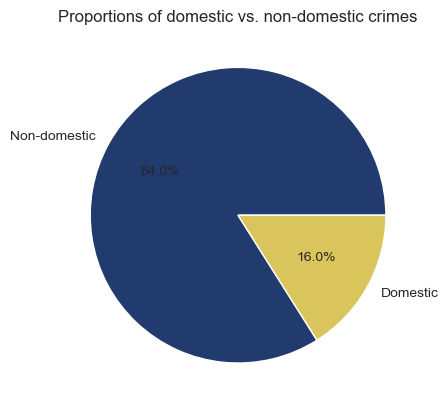

In [59]:
df_by_domestic = df.Domestic.value_counts()

sns.set_style("darkgrid")

#define Seaborn color palette to use
colors = [sns.color_palette('cividis')[0],
          sns.color_palette('cividis')[5]]

#create pie chart
plt.pie(df_by_domestic, labels = ["Domestic", "Non-domestic"][::-1],
        colors = colors, autopct='%.1f%%')
plt.title("Proportions of domestic vs. non-domestic crimes")
plt.show()

# sns.countplot(x="Domestic", palette='cividis', data=df);

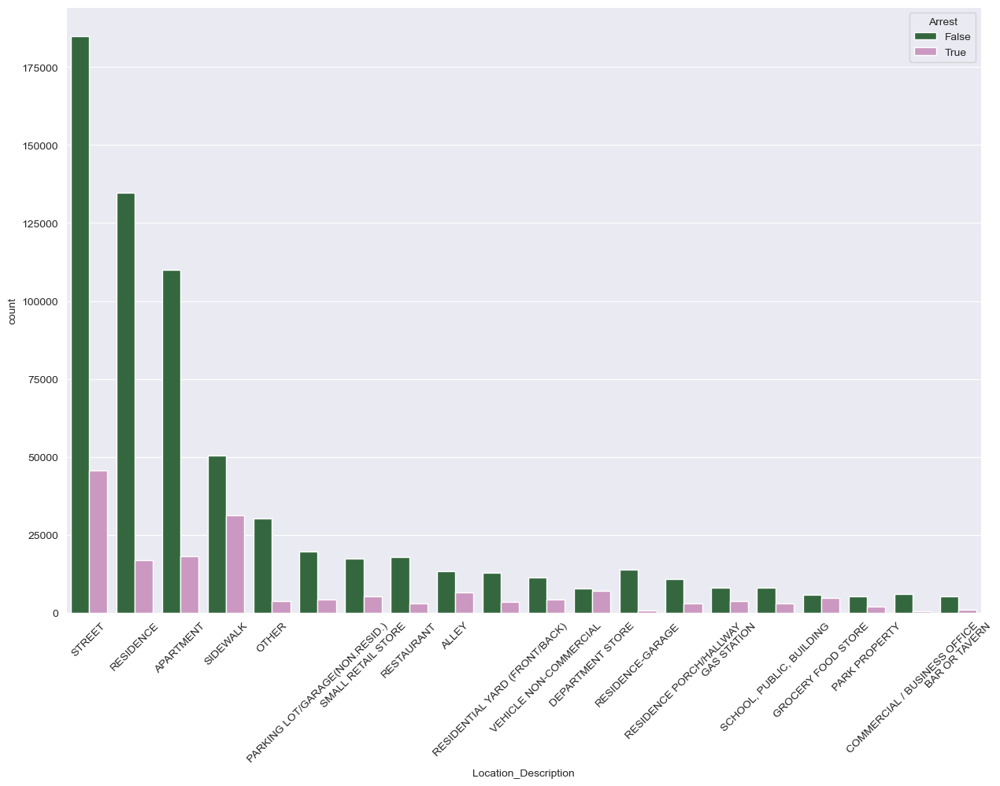

In [60]:
plt.figure(figsize = (15, 10))
plt.xticks(rotation=45)
sns.set_style('darkgrid')
sns.countplot(x= 'Location_Description',
              hue="Arrest",
              data = df,
              order = df['Location_Description'].value_counts().iloc[:20].index,
              palette='cubehelix');

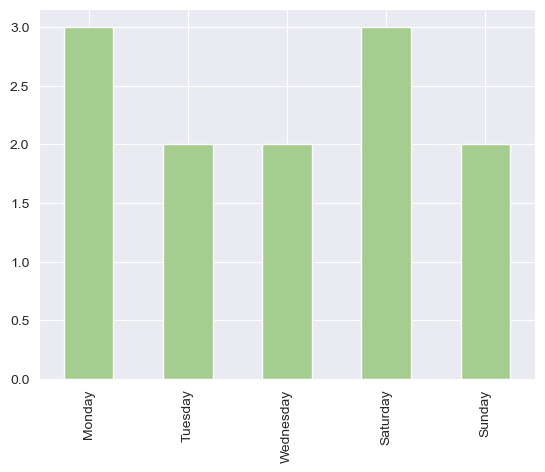

In [61]:
mask = (df.Year == 2001)
FRAC = 0.1

dow_mapping = {
    'Monday': 0,
    'Tuesday': 1,
    'Wednesday': 2,
    'Thursday': 3,
    'Friday': 4,
    'Saturday': 5,
    'Sunday': 6
}
dow_mapping = {value: key for key, value in dow_mapping.items()}

crime_counts_by_day = pd.to_datetime(df[mask].sample(frac=FRAC).Date).dt.dayofweek.value_counts()
crime_counts_by_day.sort_index(inplace=True)
crime_counts_by_day.index = [dow_mapping[key]
                             for key in crime_counts_by_day.index]
crime_counts_by_day.plot.bar(colormap="crest");

In [68]:
import plotly.express as px # another light-weighted version of plotly

# Unlike our numerical variables, our categorical ones shows more sense to us,
crimes most happen in the street, the most frequent description is "SIMPLE" and FBI Code might be better to be coded like Beat to a number.
And "100XX W OHARE ST" with 16033 frequency is the most active place of blocks apparently:

In [62]:
#Descriptive Analytics

C:\Users\HP\AppData\Local\Temp\ipykernel_17268\1657007069.py:7: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr(),annot=True, cmap='RdBu');


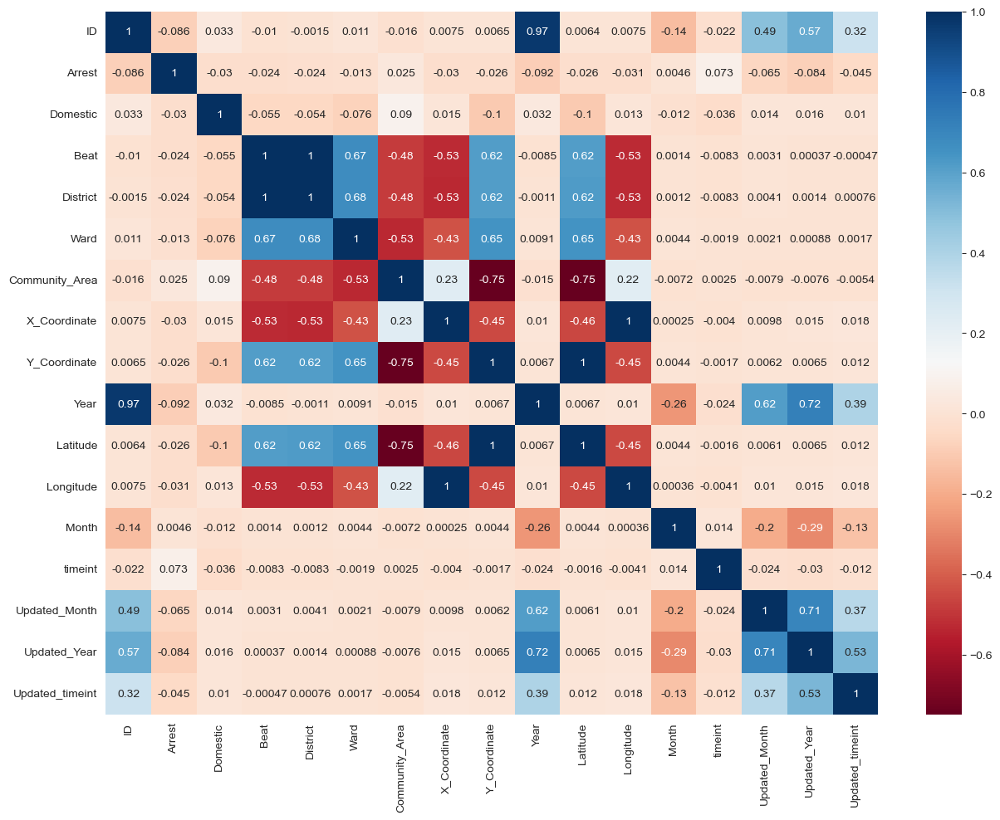

In [63]:
#Pearson's r (the Standard Correlation Coefficients)
import gc  # for force-garbage collecting

gc.collect()
plt.figure(figsize=(15,11))

sns.heatmap(df.corr(),annot=True, cmap='RdBu');

In [64]:
# the selections of relivent feature is dependent where we ploting the Heat Map Using Pearson's r (the Standard Correlation Coefficients)
# as values are from -1 to 1 so a value is  closer to +1 is show strong positive correaltion and the value is closer to -1 is show the strong Negative correlations

In [65]:
## PyChart / PyPlot for all crime types

measure = df['Crime_Type'].value_counts().sort_values()
m_index = df['Crime_Type'].value_counts().sort_values().index

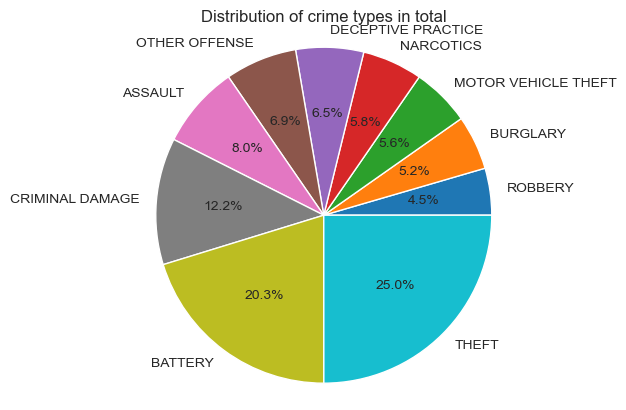

In [66]:
## PyChart / PyPlot for top 10 crimes happened

measure = df['Crime_Type'].value_counts().sort_values().tail(10)
m_index = df['Crime_Type'].value_counts().sort_values().tail(10).index

plt.pie(measure.values, labels=m_index, autopct='%1.1f%%')
plt.axis('equal')
plt.title('Distribution of crime types in total')
plt.show()

In [67]:
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix

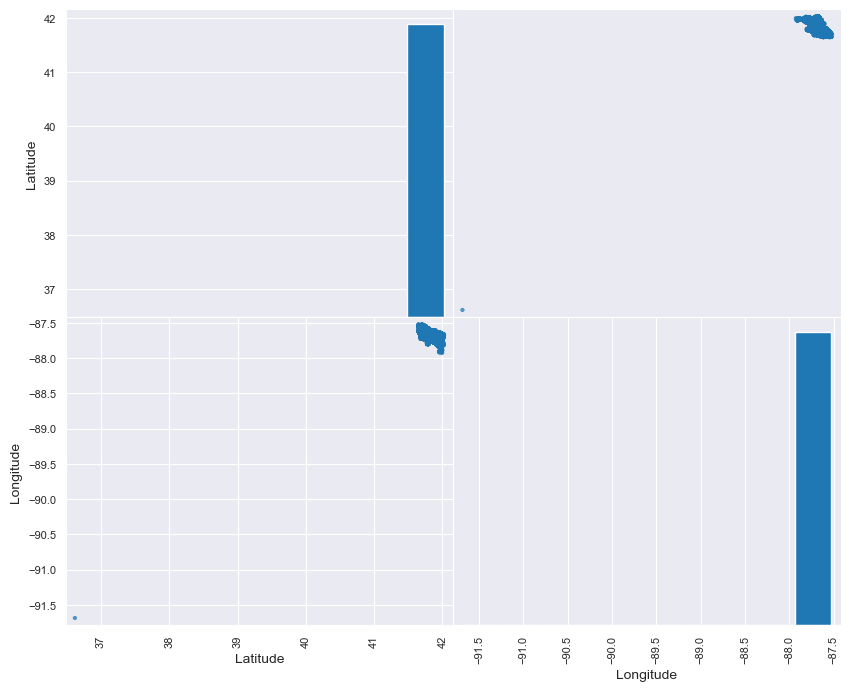

In [68]:
attributes=["Latitude", "Longitude"]
scatter_matrix(df.sample(frac=0.1)[attributes], figsize=(10, 8));

In [25]:
#Descriptive Analytics

In [68]:
  df.Beat.min(), df.Beat.max()

(111, 2535)

In [69]:
df[df["Longitude"] < -88].shape[0], df[df["Latitude"] < 41].shape[0]

(14, 14)

In [70]:
df.describe()

,ID,Beat,District,Ward,Community_Area,X_Coordinate,Y_Coordinate,Year,Latitude,Longitude,Month,timeint,Updated_Month,Updated_Year,Updated_timeint
count,9.508940e+05,950894.000000,950894.000000,950894.000000,950894.000000,9.508940e+05,9.508940e+05,950894.000000,950894.000000,950894.000000,950894.000000,950894.000000,950894.000000,950894.000000,950894.000000
mean,1.067064e+07,1148.227772,11.235634,23.015993,36.991875,1.164755e+06,1.886296e+06,2016.529602,41.843589,-87.670912,6.395492,0.559268,2.923056,2018.637267,0.663360
std,1.644965e+06,697.141610,6.959778,13.999804,21.453069,1.688242e+04,3.210211e+04,3.534236,0.088317,0.061238,3.281228,0.277013,2.032102,1.808906,0.029949
min,6.700000e+02,111.000000,1.000000,1.000000,0.000000,0.000000e+00,0.000000e+00,2001.000000,36.619446,-91.686566,1.000000,0.000000,1.000000,2006.000000,0.027083
25%,1.030638e+07,612.000000,6.000000,10.000000,23.000000,1.153112e+06,1.859276e+06,2015.000000,41.769163,-87.713159,4.000000,0.375000,2.000000,2018.000000,0.659722
50%,1.070762e+07,1024.000000,10.000000,23.000000,32.000000,1.166464e+06,1.892855e+06,2016.000000,41.861773,-87.664609,6.000000,0.593750,2.000000,2018.000000,0.659722
75%,1.107261e+07,1713.000000,17.000000,34.000000,55.000000,1.176436e+06,1.909024e+06,2017.000000,41.906221,-87.627877,9.000000,0.791667,2.000000,2018.000000,0.659722
max,1.314078e+07,2535.000000,31.000000,50.000000,77.000000,1.205119e+06,1.951535e+06,2023.000000,42.022671,-87.524529,12.000000,0.999850,12.000000,2023.000000,0.919190


The maximum beat is 2535 and minimum is 111.
An year 2001 is minimum Crime Occures and 2022 is Maximum Crime occures.
District Number 1 have Minimum crime occures as compare  to all the District as we see in the above table.The district no. 1 is safest City in UK.
Ward Number 50 is Dangerious area for the new people beacuse Maximum crime occures in these Ward .
In chicago city District no.1 is safest.

In [71]:
df.columns

Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Crime_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Updated_On', 'Latitude', 'Longitude', 'Location', 'Month',
       'Day', 'Time', 'timeint', 'Updated_Date', 'Updated_Month',
       'Updated_Day', 'Updated_Year', 'Updated_Time', 'Updated_timeint'],
      dtype='object')

In [23]:
from statsmodels.stats import weightstats
import scipy.stats as stats

In [24]:
#df.mean()

In [25]:
#  In above table ,these the average crime occures in chixago city.

In [26]:
#df.mode()

In [27]:
# in chicago city the Theft(Crime_type) Maximum time occure in Street(Location_dis.).

In [28]:
#df.skew()

In [29]:
#Crimes over time
#What area had the most crime?
# District no. 1 had less crime occures.

In [23]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(df, test_size=0.05, random_state=42)
# if the dataset gets updated, then there's no guarantee that this
# can replicate the results

In [24]:
train.to_csv("chicago-train.csv", index=False)
test.to_csv("chicago-test.csv", index=False)
# !mv chicago-test.csv /content/gdrive/MyDrive/
# !mv chicago-train.csv /content/gdrive/MyDrive/
TRAIN_PATH = "chicago-train.csv"
TEST_PATH = "Chicago-test.csv"

In [25]:
#Handling Categorical Variables

In [26]:
train["Year"].nunique()
train["FBI_Code"].value_counts()
# using pd.factorize() to encode these categories into numbers
train['Year'] = pd.factorize(train["Year"])[0]
train["FBI_Code"] = pd.factorize(train["FBI_Code"])[0]

In [27]:
#Separating numerical and categorical columns:

train["Year"].value_counts()
numerical_cols = train.select_dtypes(exclude=['object']).columns
categorical_cols = train.select_dtypes(include=['object']).columns
print(*categorical_cols, sep=", ")

Case_Number, Date, Block, IUCR(Illinois_Uniform_Crime_Reporting), Crime_Type, Description, Location_Description, Location, Day, Time, Updated_Date, Updated_Day, Updated_Time


In [28]:
print(*numerical_cols, sep=", ")
train["Crime_Type"].nunique()
train["Description"].nunique()
train["Location_Description"].nunique()

ID, Arrest, Domestic, Beat, District, Ward, Community_Area, FBI_Code, X_Coordinate, Y_Coordinate, Year, Updated_On, Latitude, Longitude, Month, timeint, Updated_Month, Updated_Year, Updated_timeint


160

In [29]:
###Using Logistic Regression

In [30]:
df_train = df.drop(['Updated_On','Location'],axis = 1)
## df.drop(['Updated_On','Location'],axis = 1)
df_train.columns

Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Crime_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Latitude', 'Longitude', 'Month', 'Day', 'Time', 'timeint',
       'Updated_Date', 'Updated_Month', 'Updated_Day', 'Updated_Year',
       'Updated_Time', 'Updated_timeint'],
      dtype='object')

In [31]:
df.Beat.min(), df.Beat.max(),df.Beat.mean()

(111, 2535, 1148.2277719703773)

In [32]:
df_train.groupby("Crime_Type")['Crime_Type'].count().sort_values()

Crime_Type
NON-CRIMINAL (SUBJECT SPECIFIED)          3
OTHER NARCOTIC VIOLATION                 21
NON - CRIMINAL                           23
PUBLIC INDECENCY                         35
HUMAN TRAFFICKING                        35
NON-CRIMINAL                             96
OBSCENITY                               206
CONCEALED CARRY LICENSE VIOLATION       249
HOMICIDE                                251
INTIMIDATION                            564
KIDNAPPING                              661
STALKING                                772
GAMBLING                                862
LIQUOR LAW VIOLATION                    899
CRIMINAL SEXUAL ASSAULT                1108
ARSON                                  1774
PROSTITUTION                           3317
INTERFERENCE WITH PUBLIC OFFICER       3546
SEX OFFENSE                            3587
CRIM SEXUAL ASSAULT                    4179
PUBLIC PEACE VIOLATION                 5973
OFFENSE INVOLVING CHILDREN             7560
WEAPONS VIOLATION    

In [33]:
df_train.groupby('Date')['Date'].count().sort_values()

Date
2021-04-20       1
2014-02-06       1
2002-03-11       1
2002-03-01       1
2002-02-23       1
              ... 
2023-01-01     944
2015-08-01     959
2016-09-01     975
2016-01-01     978
2017-01-01    1007
Name: Date, Length: 7860, dtype: int64

In [34]:
year = df_train.groupby('Year')['Arrest','Domestic'].count()
df.Beat

C:\Users\HP\AppData\Local\Temp\ipykernel_9764\3482308180.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  year = df_train.groupby('Year')['Arrest','Domestic'].count()


6           222
11         1915
15          224
17         1123
23         1923
           ... 
1048570    2232
1048571    2521
1048572     822
1048573    1634
1048574    1132
Name: Beat, Length: 950894, dtype: int64

In [35]:
## Bar chart / Line chart (crimes for per year)

year = df_train.groupby('Year')['Year'].count()
year


Year
2001       121
2002      4104
2003      5487
2004      5493
2005      5188
2006      5259
2007      5315
2008      5223
2009      4708
2010      4723
2011      4319
2012      4166
2013      3934
2014      4298
2015    211086
2016    265646
2017    263011
2018      9658
2019      2983
2020      2342
2021      2243
2022      2541
2023    129046
Name: Year, dtype: int64

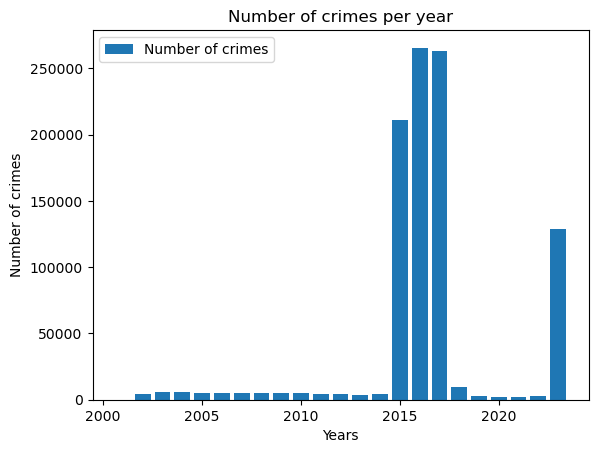

In [36]:
plt.bar(year.index,year.values,label='Number of crimes')

plt.title("Number of crimes per year")
plt.xlabel("Years")
plt.ylabel("Number of crimes")

plt.legend()
plt.show()

In [37]:
# maximum crime occures between year 2015 to 2020

In [38]:
block = df_train.groupby('Block')['Block'].count().sort_values().tail(10)
block

Block
055XX S ASHLAND AVE          846
0000X S STATE ST             932
076XX S CICERO AVE          1031
059XX N GLENWOOD AVE        1122
0000X N STATE ST            1195
075XX S STONY ISLAND AVE    1385
0000X W TERMINAL ST         1607
054XX S WENTWORTH AVE       1895
008XX N MICHIGAN AVE        2184
001XX N STATE ST            2887
Name: Block, dtype: int64

In [39]:
#df.groupby(['Block']).sum()
df.groupby(['Block']).size().sort_values(ascending=False)

Block
001XX N STATE ST            2887
008XX N MICHIGAN AVE        2184
054XX S WENTWORTH AVE       1895
0000X W TERMINAL ST         1607
075XX S STONY ISLAND AVE    1385
                            ... 
012XX W Newport Ave            1
005XX W 26th ST                1
016XX E Hyde Park Blvd         1
012XX W Madison St             1
070XX W BALMORAL AVE           1
Length: 32565, dtype: int64

In [40]:
#df.groupby(['Block']).sum()
df.groupby(['Block']).size().sort_values(ascending=False)

Block
001XX N STATE ST            2887
008XX N MICHIGAN AVE        2184
054XX S WENTWORTH AVE       1895
0000X W TERMINAL ST         1607
075XX S STONY ISLAND AVE    1385
                            ... 
012XX W Newport Ave            1
005XX W 26th ST                1
016XX E Hyde Park Blvd         1
012XX W Madison St             1
070XX W BALMORAL AVE           1
Length: 32565, dtype: int64

In [41]:
## Scatter plot

df_matrix = df_train[['Latitude', 'Longitude']].values
df_train[['Latitude']].values

array([[41.81399924],
       [41.95458447],
       [41.80852139],
       ...,
       [41.79302493],
       [41.94053913],
       [41.87322086]])

In [42]:
df_train[df_train["Longitude"] < -88].shape[0], df_train[df_train["Latitude"] < 41].shape[0]

(14, 14)

In [43]:
## Feature Extraction

used_features = ['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Crime_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Latitude', 'Longitude']
x = df_train[used_features].values
print(type(x))


<class 'numpy.ndarray'>


In [44]:
df_train.iloc[:,-1]

6          0.659722
11         0.659722
15         0.659722
17         0.659722
23         0.484236
             ...   
1048570    0.660417
1048571    0.660417
1048572    0.660417
1048573    0.660417
1048574    0.660417
Name: Updated_timeint, Length: 950894, dtype: float64

In [45]:
## Multicoliniarity
df.corr()

C:\Users\HP\AppData\Local\Temp\ipykernel_9764\2869692585.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,ID,Arrest,Domestic,Beat,District,Ward,Community_Area,X_Coordinate,Y_Coordinate,Year,Latitude,Longitude,Month,timeint,Updated_Month,Updated_Year,Updated_timeint
ID,1.000000,-0.085648,0.032602,-0.010190,-0.001490,0.010826,-0.016146,0.007486,0.006457,0.969368,0.006434,0.007495,-0.144339,-0.021562,0.494442,0.565399,0.315956
Arrest,-0.085648,1.000000,-0.030252,-0.024389,-0.024092,-0.012568,0.024812,-0.029959,-0.026089,-0.092023,-0.025907,-0.030676,0.004585,0.072626,-0.064856,-0.083829,-0.044964
Domestic,0.032602,-0.030252,1.000000,-0.054522,-0.053882,-0.076048,0.090256,0.014871,-0.103857,0.031959,-0.103653,0.013392,-0.012391,-0.036399,0.013989,0.015940,0.010281
Beat,-0.010190,-0.024389,-0.054522,1.000000,0.996915,0.672611,-0.484422,-0.528451,0.615446,-0.008489,0.616014,-0.525432,0.001405,-0.008290,0.003065,0.000373,-0.000471
District,-0.001490,-0.024092,-0.053882,0.996915,1.000000,0.676283,-0.484621,-0.531984,0.617106,-0.001095,0.617684,-0.528981,0.001237,-0.008316,0.004051,0.001351,0.000755
Ward,0.010826,-0.012568,-0.076048,0.672611,0.676283,1.000000,-0.532025,-0.433388,0.648713,0.009146,0.648806,-0.428717,0.004357,-0.001883,0.002065,0.000885,0.001694
Community_Area,-0.016146,0.024812,0.090256,-0.484422,-0.484621,-0.532025,1.000000,0.232697,-0.748056,-0.015440,-0.747095,0.224228,-0.007214,0.002507,-0.007877,-0.007610,-0.005425
X_Coordinate,0.007486,-0.029959,0.014871,-0.528451,-0.531984,-0.433388,0.232697,1.000000,-0.453711,0.010299,-0.455707,0.999832,0.000250,-0.003977,0.009790,0.014539,0.018228
Y_Coordinate,0.006457,-0.026089,-0.103857,0.615446,0.617106,0.648713,-0.748056,-0.453711,1.000000,0.006722,0.999994,-0.448458,0.004375,-0.001667,0.006156,0.006519,0.011593
Year,0.969368,-0.092023,0.031959,-0.008489,-0.001095,0.009146,-0.015440,0.010299,0.006722,1.000000,0.006684,0.010367,-0.261273,-0.024019,0.617560,0.720504,0.392511


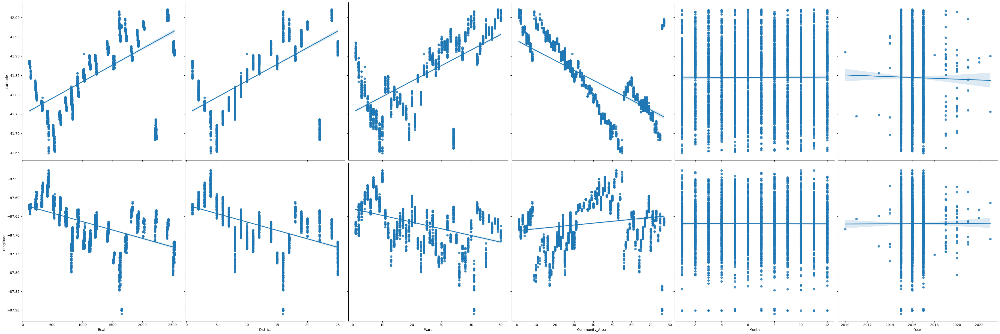

In [46]:
## Pair plot for 5000 records

new_df = df_train.head(5000)

## new_df['Arrest'].replace({'TRUE' : 1, 'FALSE' : 0}, inplace= True)
## new_df['Domestic'].replace({'TRUE' : 1, 'FALSE' : 0}, inplace= True)

sns.pairplot(new_df,x_vars = [ "Beat", "District", "Ward",
                 "Community_Area", "Month","Year"],
            y_vars = ["Latitude", "Longitude"],height = 7,aspect = 1,
            kind = 'reg')
plt.show()

In [47]:
#Logistic Regressions

In [48]:
feature_cols = ["Arrest"]
x = df_train[feature_cols]
y = df_train[ "Domestic"]
type(y)
type

type

In [49]:
x

,Arrest
6,False
11,True
15,False
17,False
23,True
...,...
1048570,False
1048571,False
1048572,False
1048573,False


In [50]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size = 0.20,random_state = 23)

In [51]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(760715, 1)
(190179, 1)
(760715,)
(190179,)


In [52]:
len(y_train),len(x_train)

(760715, 760715)

In [53]:
type(x_train.size)

numpy.int32

In [54]:
type(y_train.size)

int

In [55]:
from sklearn.linear_model import LogisticRegression
LogReg = LogisticRegression()

In [56]:
LogReg.fit(x_train,y_train)

LogisticRegression()

In [57]:
y_predict=LogReg.predict(x_test)
y_predict

array([False, False, False, ..., False, False, False])

In [58]:
y_test,x_test

(193276      True
 298685     False
 1039948    False
 858072     False
 695593     False
            ...  
 223908     False
 520104     False
 866289      True
 40988      False
 217338     False
 Name: Domestic, Length: 190179, dtype: bool,
          Arrest
 193276    False
 298685    False
 1039948   False
 858072    False
 695593    False
 ...         ...
 223908     True
 520104    False
 866289    False
 40988     False
 217338    False
 
 [190179 rows x 1 columns])

In [59]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [60]:
metrics.confusion_matrix(y_test,y_predict)

array([[159621,      0],
       [ 30558,      0]], dtype=int64)

In [61]:
metrics.accuracy_score(y_test,y_predict)

0.8393197987159465

In [62]:
print(classification_report(y_test,y_predict))

C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

       False       0.84      1.00      0.91    159621
        True       0.00      0.00      0.00     30558

    accuracy                           0.84    190179
   macro avg       0.42      0.50      0.46    190179
weighted avg       0.70      0.84      0.77    190179



C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [63]:
LogReg.coef_

array([[-0.21385515]])

In [64]:
#How we get 

In [65]:
LogReg.intercept_

array([-1.61529953])

In [66]:
#df_train_dummied[used_features].columns

In [67]:
LogReg.predict_proba(x_test)

array([[0.83414586, 0.16585414],
       [0.83414586, 0.16585414],
       [0.83414586, 0.16585414],
       ...,
       [0.83414586, 0.16585414],
       [0.83414586, 0.16585414],
       [0.83414586, 0.16585414]])

In [68]:
## o/p in the form of intercept or slope
## corr gives probability of inceasing or decreasing
## coef gives us ratio of x to the y

In [69]:
import time
import random
from math import *
import operator
import pandas as pd
import numpy as np

# import plotting libraries
import matplotlib
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix
%matplotlib inline

import seaborn as sns
sns.set(style="white", color_codes=True)
sns.set(font_scale=1.5)

# import the ML algorithm
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from statsmodels.tools.eval_measures import rmse
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import BernoulliNB

# pre-processing
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import scale
from sklearn.preprocessing import minmax_scale
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import Normalizer
#from sklearn.preprocessing import Imputer
from sklearn.preprocessing import LabelEncoder


# import libraries for model validation
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import LeaveOneOut

# import libraries for metrics and reporting
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn import metrics
from sklearn.metrics import classification_report

In [70]:
# Instantiate the classifier
from sklearn.linear_model import LogisticRegression
from sklearn.datasets import load_breast_cancer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
LogReg = LogisticRegression(random_state=0)

In [71]:
print(x_train.shape)
print(y_train.shape)

(760715, 1)
(760715,)


In [72]:
# Train classifier
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()
logreg.fit(x_train , y_train)

LogisticRegression()

In [73]:
#logreg.predict([233])
## "Beat"

In [74]:
y_pred = logreg.predict(x_test)

In [75]:
from sklearn import metrics

print('beta coeficient         :' ,logreg.coef_)


beta coeficient         : [[-0.21385515]]


In [76]:
import statsmodels.formula.api as smf
sm_model = smf.ols(formula='Latitude ~ Beat + District + Ward + Community_Area + Month + Year',data = df_train).fit()

In [77]:
sm_model2  = smf.ols(formula='Latitude ~ District + Ward + Community_Area + Month + Year',data = df_train).fit()

In [78]:
sm_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               Latitude   R-squared:                       0.669
Model:                            OLS   Adj. R-squared:                  0.669
Method:                 Least Squares   F-statistic:                 3.204e+05
Date:                Tue, 03 Oct 2023   Prob (F-statistic):               0.00
Time:                        01:49:34   Log-Likelihood:             1.4841e+06
No. Observations:              950894   AIC:                        -2.968e+06
Df Residuals:                  950887   BIC:                        -2.968e+06
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept         42.0544      0.031   1357.192      0.000      41.994      42.115
Beat           -2.262e-06   9.58e-07     -2.362      0.018   -4.14e-06   -3.85e-07
District           0.0029   9.63e-05     29.895      0.000       0.003       0.003
Ward               0.0014   5.33e-06    270.406      0.000       0.001       0.001
Community_Area    -0.0022   2.93e-06   -736.825      0.000      -0.002      -0.002
Month          -4.515e-05   1.65e-05     -2.743      0.006   -7.74e-05   -1.29e-05
Year           -9.602e-05   1.53e-05     -6.256      0.000      -0.000   -6.59e-05
==============================================================================
Omnibus:                  1959205.817   Durbin-Watson:                   1.911
Prob(Omnibus):                  0.000   Jarque-Bera (JB):     114062422146.836
Skew:                         -16.299   Prob(JB):                         0.00
Kurtosis:                    1699.409   Cond. No.                     1.40e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.4e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [80]:
sm_model2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               Latitude   R-squared:                       0.669
Model:                            OLS   Adj. R-squared:                  0.669
Method:                 Least Squares   F-statistic:                 3.845e+05
Date:                Tue, 03 Oct 2023   Prob (F-statistic):               0.00
Time:                        01:49:37   Log-Likelihood:             1.4841e+06
No. Observations:              950894   AIC:                        -2.968e+06
Df Residuals:                  950888   BIC:                        -2.968e+06
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept         42.0472      0.031   1363.551      0.000      41.987      42.108
District           0.0027   1.04e-05    255.722      0.000       0.003       0.003
Ward               0.0014   5.33e-06    270.648      0.000       0.001       0.001
Community_Area    -0.0022   2.93e-06   -737.102      0.000      -0.002      -0.002
Month          -4.424e-05   1.65e-05     -2.689      0.007   -7.65e-05    -1.2e-05
Year           -9.249e-05   1.53e-05     -6.055      0.000      -0.000   -6.26e-05
==============================================================================
Omnibus:                  1959197.838   Durbin-Watson:                   1.911
Prob(Omnibus):                  0.000   Jarque-Bera (JB):     114054516357.065
Skew:                         -16.299   Prob(JB):                         0.00
Kurtosis:                    1699.351   Cond. No.                     1.19e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.19e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [81]:
sm_model.rsquared,sm_model.rsquared_adj

(0.6690533636739384, 0.6690512754344127)

In [82]:
sm_model2.rsquared,sm_model2.rsquared_adj

(0.6690514223771187, 0.6690496821691361)

In [83]:
sm_model.pvalues

Intercept          0.000000e+00
Beat               1.818977e-02
District          2.779846e-196
Ward               0.000000e+00
Community_Area     0.000000e+00
Month              6.079578e-03
Year               3.963932e-10
dtype: float64

In [84]:
sm_model.params

Intercept         42.054422
Beat              -0.000002
District           0.002879
Ward               0.001441
Community_Area    -0.002158
Month             -0.000045
Year              -0.000096
dtype: float64

In [85]:
max(sm_model.pvalues)

0.018189766341467063

In [86]:
sm_model2.pvalues

Intercept         0.000000e+00
District          0.000000e+00
Ward              0.000000e+00
Community_Area    0.000000e+00
Month             7.171819e-03
Year              1.408734e-09
dtype: float64

In [87]:
sm_model2.params

Intercept         42.047234
District           0.002653
Ward               0.001442
Community_Area    -0.002158
Month             -0.000044
Year              -0.000092
dtype: float64

In [88]:
max(sm_model2.pvalues)

0.0071718188412524565

In [89]:
feature_cols1 = ["Intercept", "Beat", "District", "Ward",
                 "Community_Area", "Month", "Year"]
feature_cols1

['Intercept', 'Beat', 'District', 'Ward', 'Community_Area', 'Month', 'Year']

In [90]:
list(zip(feature_cols1,sm_model.pvalues))

[('Intercept', 0.0),
 ('Beat', 0.018189766341467063),
 ('District', 2.779846443435559e-196),
 ('Ward', 0.0),
 ('Community_Area', 0.0),
 ('Month', 0.006079577949322603),
 ('Year', 3.96393168046295e-10)]

In [91]:
feature_cols2 = ["Intercept","District", "Ward",
                 "Community_Area", "Month", "Year"]
feature_cols2

['Intercept', 'District', 'Ward', 'Community_Area', 'Month', 'Year']

In [92]:
feature_cols = ["Arrest"]
feature_column=["Domestic"]
x = df_train[feature_cols]
y = df_train[feature_column]
type(y)
type(x)

pandas.core.frame.DataFrame

<Figure size 1200x600 with 0 Axes>

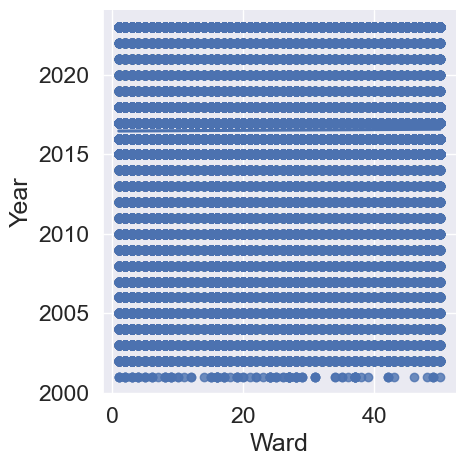

In [93]:
plt.figure(figsize=(12,6))
sns.lmplot(x='Ward', y = 'Year', data = df, ci = None)

In [94]:
# Decision Tree 

In [95]:
import graphviz 
from sklearn.tree import export_graphviz
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import DecisionTreeClassifier
dtclf = DecisionTreeClassifier(criterion = 'entropy')
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

In [96]:
df.columns

Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Crime_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Updated_On', 'Latitude', 'Longitude', 'Location', 'Month',
       'Day', 'Time', 'timeint', 'Updated_Date', 'Updated_Month',
       'Updated_Day', 'Updated_Year', 'Updated_Time', 'Updated_timeint'],
      dtype='object')

In [97]:
A = df[['Year', 'ID']]
B = df['Arrest']
print(A)
B

         Year        ID
6        2015  10224881
11       2015  10225155
15       2015  10225206
17       2015  10225234
23       2015  10225308
...       ...       ...
1048570  2018  11202882
1048571  2018  11202883
1048572  2018  11202884
1048573  2018  11202885
1048574  2018  11202886

[950894 rows x 2 columns]


6          False
11          True
15         False
17         False
23          True
           ...  
1048570    False
1048571    False
1048572    False
1048573    False
1048574     True
Name: Arrest, Length: 950894, dtype: bool

In [98]:
A = A.values
B = B.values

In [99]:
A

array([[    2015, 10224881],
       [    2015, 10225155],
       [    2015, 10225206],
       ...,
       [    2018, 11202884],
       [    2018, 11202885],
       [    2018, 11202886]], dtype=int64)

In [100]:
B

array([False,  True, False, ..., False, False,  True])

In [101]:
from sklearn import tree

In [102]:
clf = tree.DecisionTreeClassifier()

clf = clf.fit(A, B)

In [103]:
# After being fitted, the model can then be used to predict the class of samples:
clf.predict([[2., 1.]])

array([ True])

In [104]:
# Alternatively, the probability of each class can be predicted, which is the fraction of 
# training samples of the same class in a leaf
clf.predict_proba([[0, 3.]])

array([[0., 1.]])

In [105]:
from sklearn import tree
clf = tree.DecisionTreeClassifier(criterion='entropy')
clf.fit(x_train, y_train)

DecisionTreeClassifier(criterion='entropy')

In [106]:
clf

DecisionTreeClassifier(criterion='entropy')

In [107]:
df.drop('Arrest', 1).columns

C:\Users\HP\AppData\Local\Temp\ipykernel_9764\4164386399.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df.drop('Arrest', 1).columns


Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Crime_Type', 'Description',
       'Location_Description', 'Domestic', 'Beat', 'District', 'Ward',
       'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate', 'Year',
       'Updated_On', 'Latitude', 'Longitude', 'Location', 'Month', 'Day',
       'Time', 'timeint', 'Updated_Date', 'Updated_Month', 'Updated_Day',
       'Updated_Year', 'Updated_Time', 'Updated_timeint'],
      dtype='object')

In [108]:
! pip install graphviz

Defaulting to user installation because normal site-packages is not writeable


In [109]:
conda install python-graphviz


Note: you may need to restart the kernel to use updated packages.



EnvironmentLocationNotFound: Not a conda environment: C:\ProgramData\anaconda3\New



In [110]:
import graphviz 
from sklearn.tree import export_graphviz

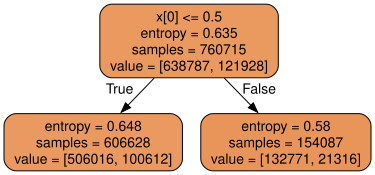

In [111]:
dot_data = export_graphviz(clf, 
                         out_file=None, 
                        
                          #class_names=y.unique(),  
                          filled=True, 
                          rounded=True,
                          special_characters= False)  

graph = graphviz.Source(dot_data)  

#graph.render(r"E:\Python\Machine Learning\DT_graph")
graph 

In [112]:
#Random Forest

In [113]:
# AUC-ROC

In [114]:
from sklearn.datasets import make_classification

import numpy as np

In [115]:
A,B = make_classification(n_samples=10000, n_classes=2, n_features=5, random_state=0)

In [116]:
A.shape

(10000, 5)

In [117]:
B.shape

(10000,)

In [118]:
import numpy as np
random_state = np.random.RandomState(0)
n_samples, n_features = A.shape
X = np.c_[A, random_state.randn(n_samples, 50 * n_features)]

In [119]:
A.shape

(10000, 5)

In [120]:
X_train, X_test, Y_train, Y_test = train_test_split(A, B, test_size=.2,
                                                    random_state=0)

In [121]:
X_train.shape

(8000, 5)

In [122]:
len(Y_train)

8000

In [123]:
dt=DecisionTreeClassifier()
dt.fit(X_train, Y_train)

DecisionTreeClassifier()

In [124]:
import numpy as np
random_state = np.random.RandomState(0)
n_samples, n_features = A.shape

In [125]:
from sklearn.ensemble import RandomForestClassifier

In [126]:
rf = RandomForestClassifier(max_features=5, n_estimators=500)
rf.fit(X_train, Y_train)

RandomForestClassifier(max_features=5, n_estimators=500)

In [127]:
nb = GaussianNB()
nb.fit(X_train, Y_train)

GaussianNB()

In [128]:
len(Y_test)

2000

In [129]:
r_probs = [0 for _ in range(len(Y_test))]
dt_prob = dt.predict_proba(X_test)
rf_probs = rf.predict_proba(X_test)
nb_probs = nb.predict_proba(X_test)

In [130]:
rf_probs[:,1]

array([0.088, 0.   , 0.012, ..., 0.   , 0.92 , 0.494])

In [131]:
dt_prob

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       ...,
       [1., 0.],
       [0., 1.],
       [1., 0.]])

In [132]:
rf_probs

array([[0.912, 0.088],
       [1.   , 0.   ],
       [0.988, 0.012],
       ...,
       [1.   , 0.   ],
       [0.08 , 0.92 ],
       [0.506, 0.494]])

In [133]:
{"Y_test":Y_test,
             "Random PRED": r_probs,
             "DT_PROBS":dt_prob.reshape(1,-1),
             "RF_PROBS": rf_probs.reshape(1,-1),
             "nb_probs":nb_probs}


{'Y_test': array([0, 0, 0, ..., 0, 1, 0]),
 'Random PRED': [0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  

In [134]:
dt_prob.shape

(2000, 2)

In [135]:
dt_prob.shape,rf_probs.shape,  nb_probs.shape

((2000, 2), (2000, 2), (2000, 2))

In [136]:
dt_probs = dt_prob[:, 1]
rf_probs = rf_probs[:, 1]
nb_probs = nb_probs[:, 1]

In [137]:
df_prob = pd.DataFrame({"Y_test":Y_test,
             "Random PRED": r_probs,
            "DT_PROBS":dt_probs,
             "RF_PROBS": rf_probs,
             "nb_probs":nb_probs})

In [138]:
df_prob.shape

(2000, 5)

In [139]:
from sklearn.metrics import roc_curve, roc_auc_score

In [140]:
# Calculate AUROC
#ROC is the receiver operating characteristic AUROC is the area under the ROC curve

In [141]:
r_auc = roc_auc_score(Y_test, r_probs)
dt_auc = roc_auc_score(Y_test, dt_probs)
rf_auc = roc_auc_score(Y_test, rf_probs)
nb_auc = roc_auc_score(Y_test, nb_probs)

In [142]:
print('Random (chance) Prediction: AUROC = %.3f' % (r_auc))
print('Decision Tree: AUROC = %.3f' % (dt_auc))
print('Random Forest: AUROC = %.3f' % (rf_auc))
print('Naive Bayes: AUROC = %.3f' % (nb_auc))

Random (chance) Prediction: AUROC = 0.500
Decision Tree: AUROC = 0.877
Random Forest: AUROC = 0.968
Naive Bayes: AUROC = 0.879


In [143]:
from sklearn.metrics import confusion_matrix

In [144]:
Y_test, rf_probs[1]

(array([0, 0, 0, ..., 0, 1, 0]), 0.0)

In [145]:
a,b,c = (10,20,30)

In [146]:
r_fpr, r_tpr, r_thresh = roc_curve(Y_test, r_probs)
dt_fpr, dt_tpr, dt_thresh = roc_curve(Y_test, dt_probs)
rf_fpr, rf_tpr, rf_thresh = roc_curve(Y_test, rf_probs)
nb_fpr, nb_tpr, nb_thresh = roc_curve(Y_test, nb_probs)

In [147]:
rf_thresh

array([2.   , 1.   , 0.998, 0.996, 0.994, 0.992, 0.99 , 0.988, 0.986,
       0.984, 0.982, 0.98 , 0.978, 0.976, 0.974, 0.972, 0.97 , 0.968,
       0.966, 0.964, 0.962, 0.96 , 0.958, 0.956, 0.954, 0.952, 0.95 ,
       0.948, 0.946, 0.944, 0.942, 0.94 , 0.938, 0.936, 0.932, 0.928,
       0.926, 0.922, 0.92 , 0.918, 0.916, 0.914, 0.912, 0.908, 0.906,
       0.904, 0.902, 0.9  , 0.898, 0.896, 0.894, 0.892, 0.89 , 0.888,
       0.884, 0.882, 0.88 , 0.878, 0.876, 0.874, 0.872, 0.87 , 0.868,
       0.866, 0.864, 0.862, 0.858, 0.856, 0.854, 0.848, 0.846, 0.844,
       0.84 , 0.838, 0.836, 0.834, 0.832, 0.83 , 0.828, 0.826, 0.824,
       0.82 , 0.816, 0.814, 0.81 , 0.808, 0.804, 0.802, 0.8  , 0.798,
       0.796, 0.788, 0.786, 0.784, 0.782, 0.778, 0.776, 0.772, 0.77 ,
       0.768, 0.766, 0.764, 0.76 , 0.754, 0.75 , 0.748, 0.746, 0.744,
       0.742, 0.738, 0.736, 0.732, 0.73 , 0.724, 0.718, 0.716, 0.708,
       0.706, 0.702, 0.7  , 0.694, 0.69 , 0.686, 0.684, 0.682, 0.68 ,
       0.678, 0.676,

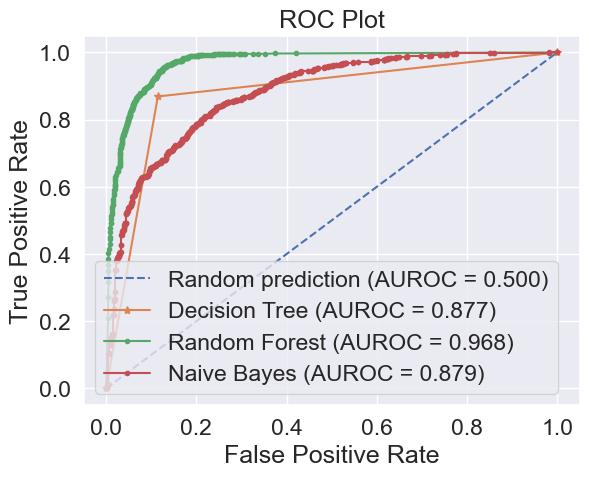

In [148]:
plt.plot(r_fpr, r_tpr, linestyle='--', label='Random prediction (AUROC = %0.3f)' % r_auc)
plt.plot(dt_fpr, dt_tpr, marker='*', label='Decision Tree (AUROC = %0.3f)' % dt_auc)
plt.plot(rf_fpr, rf_tpr, marker='.', label='Random Forest (AUROC = %0.3f)' % rf_auc)
plt.plot(nb_fpr, nb_tpr, marker='.', label='Naive Bayes (AUROC = %0.3f)' % nb_auc)

## title 
plt.title('ROC Plot')
## Axis label 
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# Show legend 
plt.legend()
# Show plot 
plt.show()


# KNN Regression

K-Nearest neighbor 
* KNN is used for both of classfication and regression predictive     problem 
* Knn is supervised learning family of algorithms.
* Distance is calculated using three type
    1)Euclidine distance
    2)Minkowski distance
    3)Mahalanobis distance
* Distance metric is compute the distance between the test sample      and all the traning samples
* distance formula
   d(x,y) = square  toot of samesion (xi -yi)

In [149]:
#K_fold

In [150]:
%%time
# set the value of k number of neighbors to choose
k = 3

# how many samples of test data to be taken out from the training data
k_fold = 5

# initialize a dataframe to store the run results
df_k_fold_validation = pd.DataFrame(columns=['k_fold_run_no', 
                                             'no_incorrect_pred', 
                                             'accuracy_pct'])

df_k_fold_validation

CPU times: total: 15.6 ms
Wall time: 24.1 ms


,k_fold_run_no,no_incorrect_pred,accuracy_pct


In [151]:
# initialize a dataframe to save all the test run results
df_results = pd.DataFrame()
df_results

""


In [152]:
# randomly shuffle the dataframe
df = df.reindex(np.random.permutation(df.index))
df

,ID,Case_Number,Date,Block,IUCR(Illinois_Uniform_Crime_Reporting),Crime_Type,Description,Location_Description,Arrest,Domestic,...,Month,Day,Time,timeint,Updated_Date,Updated_Month,Updated_Day,Updated_Year,Updated_Time,Updated_timeint
557191,10437750,HZ175813,2016-03-05,083XX S PERRY AVE,820,THEFT,$500 AND UNDER,RESIDENCE,False,True,...,3,Saturday,16:36:00,0.691667,2018-02-10,2,Saturday,2018,15:50:00,0.659722
899030,10990986,JA317672,2017-06-15,023XX W ROOSEVELT RD,1310,CRIMINAL DAMAGE,TO PROPERTY,APARTMENT,False,False,...,6,Thursday,09:00:00,0.375000,2018-02-10,2,Saturday,2018,15:50:00,0.659722
634043,10568150,HZ316211,2016-06-20,047XX N CLARK ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,COMMERCIAL / BUSINESS OFFICE,False,False,...,6,Monday,18:00:00,0.750000,2018-02-10,2,Saturday,2018,15:50:00,0.659722
427519,10212263,HY398762,2015-08-26,002XX N ADA ST,810,THEFT,OVER $500,STREET,False,False,...,8,Wednesday,17:15:00,0.718750,2018-02-10,2,Saturday,2018,15:50:00,0.659722
222565,13016214,JG192876,2023-03-20,010XX E 73RD ST,890,THEFT,FROM BUILDING,LIBRARY,False,False,...,3,Monday,19:40:00,0.819444,2023-07-15,7,Saturday,2023,16:45:57,0.698576
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
773813,10794599,HZ565273,2016-12-26,023XX S TRUMBULL AVE,486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,False,True,...,12,Monday,10:00:00,0.416667,2018-02-10,2,Saturday,2018,15:50:00,0.659722
769030,10787222,HZ556150,2016-12-17,041XX W GRAND AVE,1320,CRIMINAL DAMAGE,TO VEHICLE,VEHICLE NON-COMMERCIAL,False,False,...,12,Saturday,22:00:00,0.916667,2018-02-10,2,Saturday,2018,15:50:00,0.659722
606781,10523360,HZ266195,2016-05-16,057XX W LAWRENCE AVE,1320,CRIMINAL DAMAGE,TO VEHICLE,PARKING LOT/GARAGE(NON.RESID.),True,True,...,5,Monday,03:29:00,0.145139,2018-02-10,2,Saturday,2018,15:50:00,0.659722
322542,10026301,HY215535,2015-04-08,008XX N WABASH AVE,620,BURGLARY,UNLAWFUL ENTRY,RESTAURANT,False,False,...,4,Wednesday,23:00:00,0.958333,2018-02-10,2,Saturday,2018,15:50:00,0.659722


In [153]:
# how many records in the test data
print(len(df))
fraction = int(len(df) / k_fold)
fraction

950894


190178

In [154]:
#len(df_training_iris)
df.shape

(950894, 32)

In [155]:
import random
from math import *
import operator
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline 

import seaborn as sns
sns.set(style="white", color_codes=True)

In [156]:
df_k_fold_validation

,k_fold_run_no,no_incorrect_pred,accuracy_pct


In [ ]:
# For each k Fold 
for k_fold_ctr in range(k_fold):

    # Build test set 
    df_test = df[k_fold_ctr*fraction : k_fold_ctr*fraction+fraction]
 
    # Build Training set (removing the test set)
    index_end = k_fold_ctr*fraction
    df_before  = df[:index_end] 
    
    index_start = k_fold_ctr*fraction + fraction
    df_after = df[index_start:]  
 
    df_net = pd.concat([df_before, df_after])
    
    df_net  = df_net.reset_index(drop=True)
    
    df_test = df_test.reset_index(drop=True)
 
    # add a column for 'pred_class'
    df_test['Year'] = ''
    
    df_net['Year'] = 0
    
    # for each test sample
    for index_test, row_test in df_test.iterrows():

        # for each row in the dataframe, calculate the distance
        for index, row in df_net.iterrows():
            eucDist = sqrt(((float(row_test.ID) - float(row['ID'])) ** 2 +
                            (float(row_test.Ward) - float(row['Ward'])) ** 2 +
                            (float(row_test.Block) - float(row['Block'])) ** 2 +
                            (float(row_test.FBI_Code) - float(row['FBI_Code'])) ** 2))

            df_net.loc[index, 'Year'] = eucDist
            
        # End for - distance calculation
        
        # sort on distance, ascending.
        df_net.sort_values('Year', ascending=True, inplace=True)

        # select the first k rows, into a new df
        df_k = df_net.iloc[0:k, :].copy()

        # The resulting object will be in descending order so that the first element is the most 
        # frequently-occurring element. Excludes NA values by default.
        df_k_grouped = df_k['District'].value_counts()
        
        # get the first index of the resulting pandas series above (value_counts)
        pred_class = df_k_grouped.index[0]

        # save the predicated class in the test data frame
        df_test.at[index_test, 'Year'] = pred_class
        
    # End for - test class prediction
    # find the mismatch count of class predication
    no_mismatch_class = df_test.loc[~(df_test['Year'] == df_test['Ward'])].shape[1]

    # accuracy of prediction
    accuracy_pct = 100-(no_mismatch_class/ df_test.shape[1])*100

    print('k-fold run {:3d},'.format(k_fold_ctr), 'Accuracy = {:6.2f} %'.format(accuracy_pct))

    # save results into df_k_fold_validation
    # k_fold_ctr
    # accuracy %
    df_k_fold_validation.at[k_fold_ctr, 'k_fold_run_no'] = k_fold_ctr
    df_k_fold_validation.at[k_fold_ctr, 'no_incorrect_pred'] = no_mismatch_class
    df_k_fold_validation.at[k_fold_ctr, 'accuracy_pct'] = accuracy_pct

In [158]:
ax = df_k_fold_validation.plot(kind='line', 
        x='k_fold_run_no', 
        y='accuracy_pct', 
        figsize=(6,4),
        title= 'kNN - Accuracy % across K-folds',
        grid=True,
        legend=True,
        color='blue',
        
       );
# Set the x-axis label
ax.set_xlabel("K-fold run ")

# Set the y-axis label
ax.set_ylabel("Accuracy %");

TypeError: no numeric data to plot

In [159]:
import random
from math import *
import time
import random
from math import *
import operator


import seaborn as sns
sns.set(style="white", color_codes=True)
sns.set(font_scale=1.5)

# import the ML algorithm
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LinearRegression
from statsmodels.tools.eval_measures import rmse

# pre-processing
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import scale
from sklearn.preprocessing import minmax_scale
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import QuantileTransformer

# import libraries for model validation
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split

# import libraries for metrics and reporting
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn import metrics

from sklearn import datasets

In [160]:
skf = StratifiedKFold(n_splits=10, random_state=None)
skf

StratifiedKFold(n_splits=10, random_state=None, shuffle=False)

In [161]:
neighbors = list(range(1,30,2))
neighbors

[1, 3, 5, 7, 9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29]

In [162]:
# creating odd list of K for KNN


'myList = list(range(1, 30))\n\nneighbors = []\n\n# subsetting just the odd ones\nfor i in myList:\n    if i % 2 != 0:\n        neighbors.append(i)\n        \nneighbors'

In [163]:
X=x.head(10)
X

,Arrest
6,False
11,True
15,False
17,False
23,True
27,False
31,False
41,False
70,True
73,False


In [164]:
Y=y.head(10)
Y

,Domestic
6,False
11,False
15,False
17,False
23,False
27,False
31,False
41,False
70,False
73,False


In [165]:
# neighbors = filter(lambda x: x % 2 != 0, myList)

# empty list that will hold cv scores
cv_scores = []

# perform k-fold cross validation
for no_neighbors in neighbors:
    # instantiate the classifier
    knn = KNeighborsClassifier(n_neighbors=no_neighbors)
    
    scores = cross_val_score(knn, X, Y, cv=skf)
    
    cv_scores.append(scores.mean())

C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\neighbors\_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\neighbors\_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\neighbors\_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\neighbors\_classificat

In [166]:
# Naive Bayes 

In [167]:
from sklearn.preprocessing import StandardScaler

In [168]:
sc=StandardScaler()

In [169]:
x_train = sc.fit_transform(x_train)
x_test = sc.transform(x_test)

In [170]:
from sklearn.naive_bayes import GaussianNB

In [171]:
classifier = GaussianNB()

In [172]:
classifier.fit(x_train,y_train)

GaussianNB()

In [173]:
y=pred= classifier.predict(x_test)

In [174]:
from sklearn.metrics import confusion_matrix

In [175]:
cm= confusion_matrix(y_test,y_pred)

In [176]:
## Clusters
#Hierarchical clustering
#K-Means

In [177]:
from scipy.cluster.hierarchy import dendrogram, linkage  
import scipy.cluster.hierarchy as shc
from sklearn.cluster import AgglomerativeClustering
from matplotlib import pyplot as plt
%matplotlib inline  

In [178]:
df.columns

Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Crime_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Updated_On', 'Latitude', 'Longitude', 'Location', 'Month',
       'Day', 'Time', 'timeint', 'Updated_Date', 'Updated_Month',
       'Updated_Day', 'Updated_Year', 'Updated_Time', 'Updated_timeint'],
      dtype='object')

In [181]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 950894 entries, 557191 to 630818
Data columns (total 32 columns):
 #   Column                                  Non-Null Count   Dtype         
---  ------                                  --------------   -----         
 0   ID                                      950894 non-null  int64         
 1   Case_Number                             950894 non-null  object        
 2   Date                                    950894 non-null  object        
 3   Block                                   950894 non-null  object        
 4   IUCR(Illinois_Uniform_Crime_Reporting)  950894 non-null  object        
 5   Crime_Type                              950894 non-null  object        
 6   Description                             950894 non-null  object        
 7   Location_Description                    950894 non-null  object        
 8   Arrest                                  950894 non-null  bool          
 9   Domestic                        

In [182]:
data = df[['Month','Year']]

In [183]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn import preprocessing
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from sklearn.cluster import KMeans, DBSCAN
#from sklearn.utils import resample
#from imblearn.over_sampling import SMOTE
%matplotlib inline
sns.set_style("darkgrid")


In [184]:
#plt.figure(figsize =(10,7))
#plt.scatter(data[:,0], data[:,1], c=cluster.labels_, cmap='rainbow')

In [185]:
# K- means

In [186]:
from sklearn.cluster import KMeans
import numpy as np

In [187]:
df.columns

Index(['ID', 'Case_Number', 'Date', 'Block',
       'IUCR(Illinois_Uniform_Crime_Reporting)', 'Crime_Type', 'Description',
       'Location_Description', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'Community_Area', 'FBI_Code', 'X_Coordinate', 'Y_Coordinate',
       'Year', 'Updated_On', 'Latitude', 'Longitude', 'Location', 'Month',
       'Day', 'Time', 'timeint', 'Updated_Date', 'Updated_Month',
       'Updated_Day', 'Updated_Year', 'Updated_Time', 'Updated_timeint'],
      dtype='object')

In [188]:
x=df[['Year','ID']]
x

,Year,ID
557191,2016,10437750
899030,2017,10990986
634043,2016,10568150
427519,2015,10212263
222565,2023,13016214
...,...,...
773813,2016,10794599
769030,2016,10787222
606781,2016,10523360
322542,2015,10026301


In [189]:
x.shape

(950894, 2)

In [190]:
kmeans=KMeans(n_clusters=3)
kmeansoutput= kmeans.fit(x)

C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [191]:
kmeans.cluster_centers_

array([[2.01600955e+03, 1.05927691e+07],
       [2.00584510e+03, 4.75977898e+06],
       [2.02286479e+03, 1.29984930e+07]])

In [192]:
kmeans.inertia_

2.906428993320886e+17

In [193]:
centers = kmeans.cluster_centers_
centers

array([[2.01600955e+03, 1.05927691e+07],
       [2.00584510e+03, 4.75977898e+06],
       [2.02286479e+03, 1.29984930e+07]])

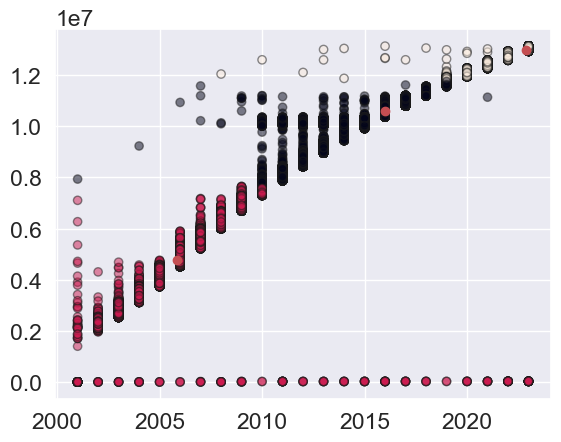

In [194]:
plt.scatter(x['Year'],
            x['ID'],
             c= kmeansoutput.labels_.astype(float),
             alpha=0.5,
             edgecolor='k')

for i in range(len(np.unique(kmeans.labels_))):
     plt.scatter(centers[i][0],centers[i][1],c='r')
        
        

In [195]:
SSD=[]
cl=[]
for i in range(1,10):
    km=KMeans(n_clusters=i)
    y=km.fit_predict(x)
    cl.append(i)

    SSD.append(km.inertia_)

C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\ProgramData\anaconda3\New folder\New folder\New folder\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Se

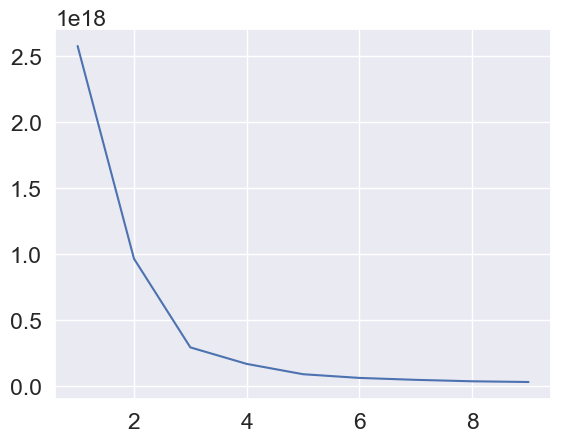

In [196]:
plt.plot(cl,SSD)

In [24]:
# TIME SERIES

In [25]:
df.dtypes

ID                                                 int64
Case_Number                                       object
Date                                              object
Block                                             object
IUCR(Illinois_Uniform_Crime_Reporting)            object
Crime_Type                                        object
Description                                       object
Location_Description                              object
Arrest                                              bool
Domestic                                            bool
Beat                                               int64
District                                         float64
Ward                                             float64
Community_Area                                   float64
FBI_Code                                          object
X_Coordinate                                     float64
Y_Coordinate                                     float64
Year                           

In [26]:
df.head()

,ID,Case_Number,Date,Block,IUCR(Illinois_Uniform_Crime_Reporting),Crime_Type,Description,Location_Description,Arrest,Domestic,...,Month,Day,Time,timeint,Updated_Date,Updated_Month,Updated_Day,Updated_Year,Updated_Time,Updated_timeint
6,10224881,HY411873,2015-09-03,044XX S UNIVERSITY AVE,1310,CRIMINAL DAMAGE,TO PROPERTY,RESIDENCE,False,False,...,9,Thursday,18:00:00,0.750000,2018-02-10,2,Saturday,2018,15:50:00,0.659722
11,10225155,HY412177,2015-09-05,007XX W IRVING PARK RD,470,PUBLIC PEACE VIOLATION,RECKLESS CONDUCT,STREET,True,False,...,9,Saturday,22:42:00,0.945833,2018-02-10,2,Saturday,2018,15:50:00,0.659722
15,10225206,HY412253,2015-09-06,047XX S STATE ST,041A,BATTERY,AGGRAVATED: HANDGUN,VACANT LOT/LAND,False,False,...,9,Sunday,01:10:00,0.048611,2018-02-10,2,Saturday,2018,15:50:00,0.659722
17,10225234,HY412306,2015-09-06,002XX N ST LOUIS AVE,420,BATTERY,AGGRAVATED:KNIFE/CUTTING INSTR,SIDEWALK,False,False,...,9,Sunday,02:00:00,0.083333,2018-02-10,2,Saturday,2018,15:50:00,0.659722
23,10225308,HY412341,2015-09-06,013XX W ADDISON ST,2230,LIQUOR LAW VIOLATION,ILLEGAL CONSUMPTION BY MINOR,SIDEWALK,True,False,...,9,Sunday,02:35:00,0.107639,2015-09-17,9,Thursday,2015,11:37:18,0.484236


In [27]:
df.tail()

,ID,Case_Number,Date,Block,IUCR(Illinois_Uniform_Crime_Reporting),Crime_Type,Description,Location_Description,Arrest,Domestic,...,Month,Day,Time,timeint,Updated_Date,Updated_Month,Updated_Day,Updated_Year,Updated_Time,Updated_timeint
1048570,11202882,JB113208,2018-01-12,103XX S HALSTED ST,1310,CRIMINAL DAMAGE,TO PROPERTY,RESTAURANT,False,False,...,1,Friday,00:50:00,0.034722,2018-05-04,5,Friday,2018,15:51:00,0.660417
1048571,11202883,JB114521,2018-01-13,031XX N LARAMIE AVE,312,ROBBERY,ARMED:KNIFE/CUTTING INSTRUMENT,SIDEWALK,False,False,...,1,Saturday,02:40:00,0.111111,2018-05-04,5,Friday,2018,15:51:00,0.660417
1048572,11202884,JB114502,2018-01-13,055XX S SPAULDING AVE,320,ROBBERY,STRONGARM - NO WEAPON,STREET,False,False,...,1,Saturday,02:07:00,0.088194,2018-05-04,5,Friday,2018,15:51:00,0.660417
1048573,11202885,JB114544,2018-01-13,051XX W SCHOOL ST,486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,1,Saturday,00:00:00,0.000000,2018-05-04,5,Friday,2018,15:51:00,0.660417
1048574,11202886,JB114527,2018-01-13,006XX S PULASKI RD,820,THEFT,$500 AND UNDER,STREET,True,False,...,1,Saturday,03:30:00,0.145833,2018-05-04,5,Friday,2018,15:51:00,0.660417


In [28]:
df.shift(1).head()

,ID,Case_Number,Date,Block,IUCR(Illinois_Uniform_Crime_Reporting),Crime_Type,Description,Location_Description,Arrest,Domestic,...,Month,Day,Time,timeint,Updated_Date,Updated_Month,Updated_Day,Updated_Year,Updated_Time,Updated_timeint
6,NaN,None,None,None,None,None,None,None,NaN,NaN,...,NaN,None,None,NaN,None,NaN,None,NaN,None,NaN
11,10224881.0,HY411873,2015-09-03,044XX S UNIVERSITY AVE,1310,CRIMINAL DAMAGE,TO PROPERTY,RESIDENCE,False,False,...,9.0,Thursday,18:00:00,0.750000,2018-02-10,2.0,Saturday,2018.0,15:50:00,0.659722
15,10225155.0,HY412177,2015-09-05,007XX W IRVING PARK RD,470,PUBLIC PEACE VIOLATION,RECKLESS CONDUCT,STREET,True,False,...,9.0,Saturday,22:42:00,0.945833,2018-02-10,2.0,Saturday,2018.0,15:50:00,0.659722
17,10225206.0,HY412253,2015-09-06,047XX S STATE ST,041A,BATTERY,AGGRAVATED: HANDGUN,VACANT LOT/LAND,False,False,...,9.0,Sunday,01:10:00,0.048611,2018-02-10,2.0,Saturday,2018.0,15:50:00,0.659722
23,10225234.0,HY412306,2015-09-06,002XX N ST LOUIS AVE,420,BATTERY,AGGRAVATED:KNIFE/CUTTING INSTR,SIDEWALK,False,False,...,9.0,Sunday,02:00:00,0.083333,2018-02-10,2.0,Saturday,2018.0,15:50:00,0.659722


In [29]:
df['Year'] = df['Ward'].shift(1)

C:\Users\gpay5\AppData\Local\Temp\ipykernel_17784\3193142167.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = df['Ward'].shift(1)


In [30]:
df.index.freq='D'
df.index

Int64Index([      6,      11,      15,      17,      23,      27,      31,
                 41,      70,      73,
            ...
            1048565, 1048566, 1048567, 1048568, 1048569, 1048570, 1048571,
            1048572, 1048573, 1048574],
           dtype='int64', length=960574)

In [31]:
df.dropna(inplace=True)

C:\Users\gpay5\AppData\Local\Temp\ipykernel_17784\1379821321.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(inplace=True)


In [32]:
df.isnull().sum()

ID                                        0
Case_Number                               0
Date                                      0
Block                                     0
IUCR(Illinois_Uniform_Crime_Reporting)    0
Crime_Type                                0
Description                               0
Location_Description                      0
Arrest                                    0
Domestic                                  0
Beat                                      0
District                                  0
Ward                                      0
Community_Area                            0
FBI_Code                                  0
X_Coordinate                              0
Y_Coordinate                              0
Year                                      0
Updated_On                                0
Latitude                                  0
Longitude                                 0
Location                                  0
Month                           

In [33]:
df.ID.count()

950255

In [34]:
950893*80/100

760714.4

In [35]:
950893 - 760714

190179

In [36]:
train = df.iloc[:760714]
test = df.iloc[760714:]


In [43]:
df1 = pd.DataFrame(df['Community_Area'])
df1.head(5)

,Community_Area
11,3.0
15,38.0
17,27.0
23,6.0
27,65.0


In [45]:
model1 = ExponentialSmoothing(df1['Community_Area'], trend = 'add', seasonal = 'add', seasonal_periods = 7).fit()
df1['halt_winters'] = model1.fittedvalues
df1.head(5)

C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\holtwinters\model.py:83: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


,Community_Area,halt_winters
11,3.0,48.636642
15,38.0,42.753388
17,27.0,29.625661
23,6.0,39.904375
27,65.0,36.945441


<Axes: >

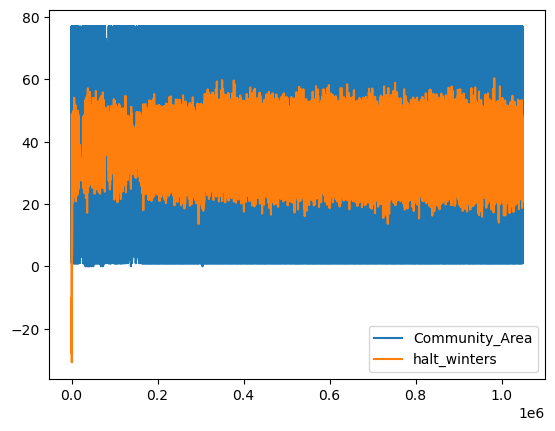

In [47]:
df1[['Community_Area','halt_winters']].plot()

In [48]:
df1['Cun_Community_Area'] = df1['Community_Area'].cumsum()
df1.head(5)

,Community_Area,halt_winters,Cun_Community_Area
11,3.0,48.636642,3.0
15,38.0,42.753388,41.0
17,27.0,29.625661,68.0
23,6.0,39.904375,74.0
27,65.0,36.945441,139.0


In [49]:
df1['Cun_Community_Area'].diff()

11          NaN
15         38.0
17         27.0
23          6.0
27         65.0
           ... 
1048570    73.0
1048571    19.0
1048572    63.0
1048573    15.0
1048574    26.0
Name: Cun_Community_Area, Length: 950255, dtype: float64

<Axes: >

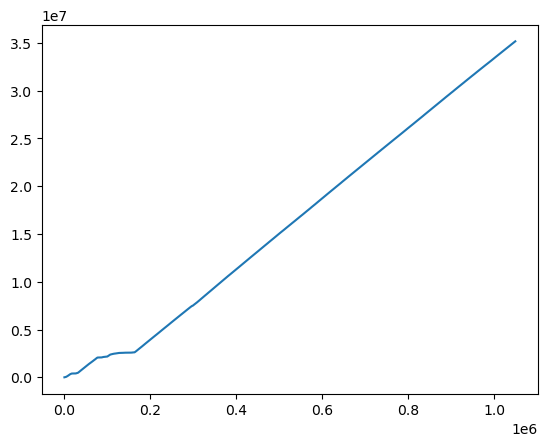

In [50]:
df1['Cun_Community_Area'].plot()

In [51]:
prediction = pd.DataFrame(model1.forecast(steps=20))
prediction.head(5)

C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


,0
950255,41.066984
950256,36.825672
950257,37.939381
950258,36.797248
950259,41.613279


In [ ]:
## Lag plot

<Axes: xlabel='y(t)', ylabel='y(t + 1)'>

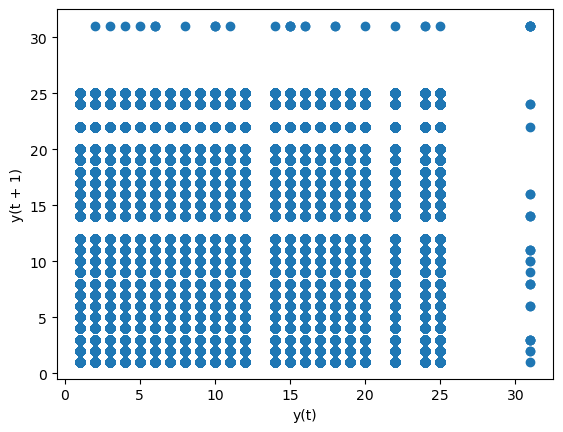

In [55]:
from pandas.plotting import lag_plot
lag_plot(df['District'])

In [ ]:
## pcf and pacf

In [59]:
dff = df.tail(50000)

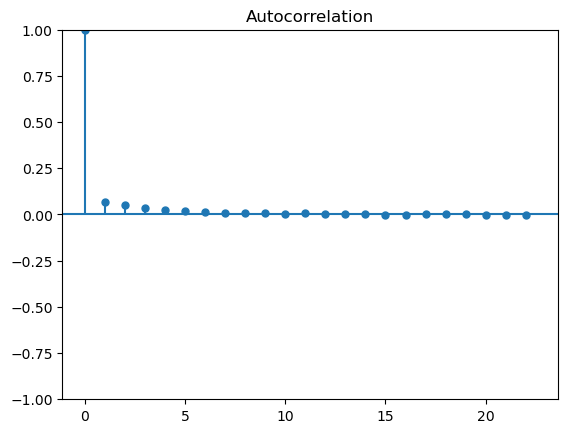

In [57]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf

plot_acf(df['District'], lags=22);

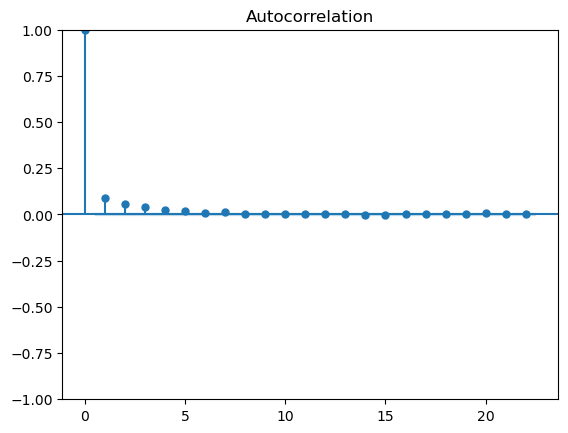

In [60]:
plot_acf(dff['Community_Area'], lags=22);

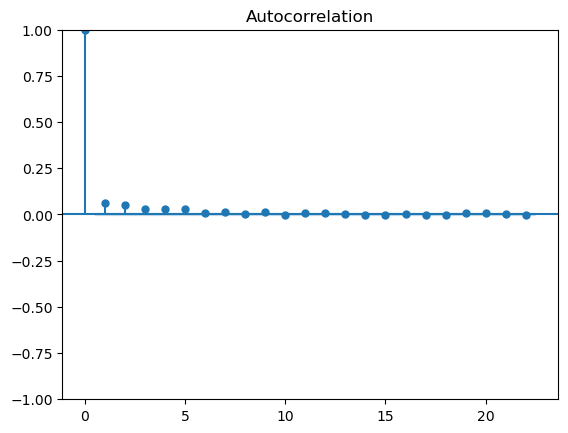

In [62]:
plot_acf(dff['Ward'], lags=22);

In [63]:
from statsmodels.tsa.ar_model import AutoReg , AutoRegResults
from sklearn.metrics import mean_squared_error

In [ ]:
predictions=[]
for i in range(70):
    model = AutoReg(train['Community_Area'],lags=i+1)
    ARfit = model.fit()
    pred = ARfit.predict(start = 382, end = 477, dynamic = False).rename('AR({val}) Predictions'.format(val = i+1))
    predictions.append(pred)

C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self.

C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self.

C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self.

C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self.

C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self.

C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\ProgramData\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self.

In [ ]:
errors=[]
for i in range(70):
    errors.append(mean_squared_error(test['Community_Area'], predictions[i]))

In [ ]:
x = errors.index(min(errors))
x

In [ ]:
test_df['Community_Area'].plot(legend=True,figsize=(20,10))
predictions1 = predictions[x]
predictions1.plot(legend=True)

In [ ]:
ARfit.predict(478,498)

In [ ]:
plot_acf(df['Community_Area'], lags=20);

In [ ]:
plot_pacf(df['Community_Area'], lags=20);

In [ ]:
#Ato check stationarity of data

In [ ]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram,linkage
import scipy.cluster.hierarchy as shc

%matplotlib inline 
from sklearn.cluster import AgglomerativeClustering
from statsmodels.tsa.stattools import adfuller

In [ ]:
result=adfuller(df['total'])
print('ADF statistic : ',result[0])

In [ ]:
print('p-value: ',result[1])

In [ ]:
print('Critical values :',result[4])

In [ ]:
if result[1]<=0.05:
    print("data is stationary")
else:
    print("data is not stationary")

In [ ]:
from pandas.plotting import lag_plot

In [ ]:
lag_plot(df['total'])
plt.title('Crime Dataset')
plt.xlabel('total(t)')
plt.ylabel('total(t+1)')
plt.show()

In [ ]:
#pcf and pacf

In [ ]:
import statsmodels.api as sm

from statsmodels.graphics.tsaplots import plot_pacf, plot_acf

In [ ]:
plot_acf(df['total'])
plt.title('ACF')
plt.show()

In [ ]:
#adfuller test

In [ ]:
def adf_test(series,title=''):
    """
    Pass in a time series and an optional title, returns an ADF report
    """
    print(f'Augmented Dickey-Fuller Test: {title}')
    result = adfuller(series.dropna(),autolag='AIC') # .dropna() handles differenced data
    
    labels = ['ADF test statistic','p-value','# lags used','# observations']
    out = pd.Series(result[0:4],index=labels)

    for key,val in result[4].items():
        out[f'critical value ({key})']=val
        
    print(out.to_string())          # .to_string() removes the line "dtype: float64"
    
    if result[1] <= 0.05:
        print("Strong evidence against the null hypothesis")
        print("Reject the null hypothesis")
        print("Data has no unit root and is stationary")
    else:
        print("Weak evidence against the null hypothesis")
        print("Fail to reject the null hypothesis")
        print("Data has a unit root and is non-stationary")

In [ ]:
df['rest2'].plot(figsize=(12,5))

In [ ]:
#ARIMA

In [ ]:
from statsmodels.tsa.arima_model import ARMA,ARMAResults,ARIMA,ARIMAResults
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA

import warnings
warnings.filterwarnings("ignore")

In [ ]:
auto_arima(df['total'],seasonal=False).summary()

In [ ]:
model=ARIMA(df['total'],order=(1,1,1))
results=model.fit()
fcast=results.predict(len(df),len(df)+20,type='levels').rename('ARIMA(1,1,1) Forecast')

In [ ]:
fcast

In [ ]:
#plot predictions against known values

title='rest2 amount and total amount'
ylabel='rest2'
xlabel=''
ax=df['total'].plot(legend=True,figsize=(12,6),title=title)
fcast.plot(legend=True)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel,ylabel=ylabel)


In [60]:
# Hypothesis Testing
"""
arrested = df['Arrested']
non_arrested = df['Arrest']"""

Arrest = df.groupby('Year')['Arrest'].count()
Arrest
res=df.groupby('Arrest')['Arrest'].agg('count').sort_values(ascending=False)
res

Arrest
False    758256
True     192638
Name: Arrest, dtype: int64

In [68]:
arrested = res[0]
non_arrested = res[1]

In [70]:
arrested, non_arrested

(758256, 192638)

In [72]:
H0 = "no of arrested is same as non arrested in year wise"
H1 = "no of arrested is not same as non arrested in year wise"

In [73]:
if stats.ttest_ind(arrested,non_arrested)[1]<0.05:
    print("Reject Null")
    print("no of arrested is same as non arrested in year wise")
else:
    print("Accept Null")
    print("no of arrested is not same as non arrested in year wise")

Accept Null
no of arrested is not same as non arrested in year wise


C:\Users\gpay5\AppData\Local\Temp\ipykernel_5604\2832571558.py:1: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  if stats.ttest_ind(arrested,non_arrested)[1]<0.05:
C:\ProgramData\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
C:\ProgramData\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning: invalid value encountered in double_scalars
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


In [74]:
H0 = "no of domestic voilence is same as non arrested in year wise"
H1 = "no of domestic voilence  is not same as non arrested in year wise"

In [75]:
if stats.ttest_ind(arrested,non_arrested)[1]<0.05:
    print("Reject Null")
    print("no of domestic voilence is same as non arrested in year wise")
else:
    print("Accept Null")
    print("no of domestic voilence is not same as non arrested in year wise")

Accept Null
no of domestic voilence is not same as non arrested in year wise


C:\Users\gpay5\AppData\Local\Temp\ipykernel_5604\1275509957.py:1: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  if stats.ttest_ind(arrested,non_arrested)[1]<0.05:


In [76]:
#compare the domestic and non_domestic Criminal in particular year.

In [77]:
domestic = df[df['Domestic']=='Yes']['Year']
non_domestic = df[df['Domestic']=='NO']['Year']
print(stats.ttest_ind(domestic,non_domestic))
alpha=0.05

Ttest_indResult(statistic=nan, pvalue=nan)


In [78]:
if stats.ttest_ind(domestic,non_domestic)[1]<0.05:
    print("Reject Null")
    print("no of domestic is same as non arrested in year wise")
else:
    print("Accept Null")
    print("no of domestic is not same as non arrested in year wise")

Accept Null
no of domestic is not same as non arrested in year wise


In [79]:
#compare the Arrested and non_Arrested Criminal in particular year.

In [82]:
print(stats.ttest_ind(arrested,non_arrested))
alpha=0.05

Ttest_indResult(statistic=nan, pvalue=nan)


C:\Users\gpay5\AppData\Local\Temp\ipykernel_5604\1153992014.py:1: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  print(stats.ttest_ind(arrested,non_arrested))


In [91]:
if stats.ttest_ind(arrested,non_arrested)[1]<0.05:
    print("Reject Null")
    print("no of arrested is same as non arrested in year wise")
else:
    print("Accept Null")
    print("no of arrested is not same as non arrested in year wise")

Accept Null
no of arrested is not same as non arrested in year wise


C:\Users\gpay5\AppData\Local\Temp\ipykernel_5604\2832571558.py:1: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  if stats.ttest_ind(arrested,non_arrested)[1]<0.05:


In [24]:
data = df.iloc[:50000,12:14].values

In [25]:
data

array([[ 4., 39.],
       [46.,  3.],
       [ 3., 38.],
       ...,
       [32.,  5.],
       [ 7., 43.],
       [28., 26.]])

In [26]:
import numpy as np
df.isna().sum()

ID                                        0
Case Number                               0
Date                                      0
Block                                     0
IUCR(Illinois Uniform Crime Reporting)    0
Primary Type                              0
Description                               0
Location Description                      0
Arrest                                    0
Domestic                                  0
Beat                                      0
District                                  0
Ward                                      0
Community Area                            0
FBI Code                                  0
X Coordinate                              0
Y Coordinate                              0
Year                                      0
Updated On                                0
Latitude                                  0
Longitude                                 0
Location                                  0
dtype: int64

In [27]:
import math
data1 = []
new = [] 
for i in data:
    i[0] = math.floor(i[0])
    i[1] = math.floor(i[1])
    new.append(i[0])
    new.append(i[1])
    data1.append(new)
data1    


[[4.0,
  39.0,
  46.0,
  3.0,
  3.0,
  38.0,
  28.0,
  27.0,
  44.0,
  6.0,
  13.0,
  65.0,
  13.0,
  65.0,
  48.0,
  77.0,
  7.0,
  46.0,
  29.0,
  25.0,
  1.0,
  24.0,
  27.0,
  28.0,
  49.0,
  1.0,
  35.0,
  21.0,
  24.0,
  27.0,
  24.0,
  27.0,
  32.0,
  6.0,
  40.0,
  2.0,
  5.0,
  41.0,
  21.0,
  71.0,
  3.0,
  61.0,
  2.0,
  28.0,
  44.0,
  6.0,
  4.0,
  41.0,
  31.0,
  19.0,
  11.0,
  60.0,
  45.0,
  16.0,
  24.0,
  29.0,
  30.0,
  21.0,
  17.0,
  71.0,
  17.0,
  68.0,
  34.0,
  49.0,
  21.0,
  49.0,
  31.0,
  22.0,
  31.0,
  19.0,
  28.0,
  29.0,
  3.0,
  37.0,
  42.0,
  8.0,
  42.0,
  8.0,
  6.0,
  44.0,
  20.0,
  42.0,
  43.0,
  7.0,
  38.0,
  15.0,
  5.0,
  42.0,
  48.0,
  77.0,
  17.0,
  68.0,
  7.0,
  43.0,
  16.0,
  67.0,
  31.0,
  20.0,
  28.0,
  26.0,
  28.0,
  25.0,
  32.0,
  24.0,
  5.0,
  43.0,
  40.0,
  2.0,
  37.0,
  23.0,
  8.0,
  43.0,
  43.0,
  7.0,
  43.0,
  7.0,
  15.0,
  66.0,
  8.0,
  43.0,
  17.0,
  71.0,
  9.0,
  50.0,
  2.0,
  8.0,
  2.0,
  27.0,
  8.0,


MemoryError: Unable to allocate 37.3 GiB for an array with shape (50000, 100000) and data type float64

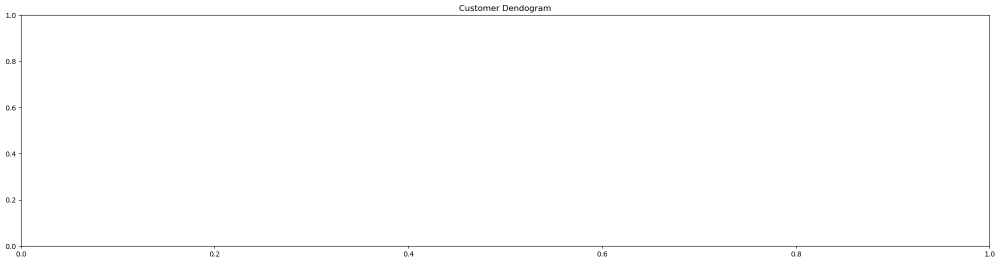

In [28]:
plt.figure(figsize = (25,6))
plt.title("Customer Dendogram")
dend = shc.dendrogram(shc.linkage(data1,method = 'ward'))